# <p style="text-align: center;">Модель прогнозирования стоимости жилья для агентства недвижимости</p>

<p style="text-align: center;">дипломный проект</p>

![Richmond, VA.png](<attachment:Richmond, VA.png>)
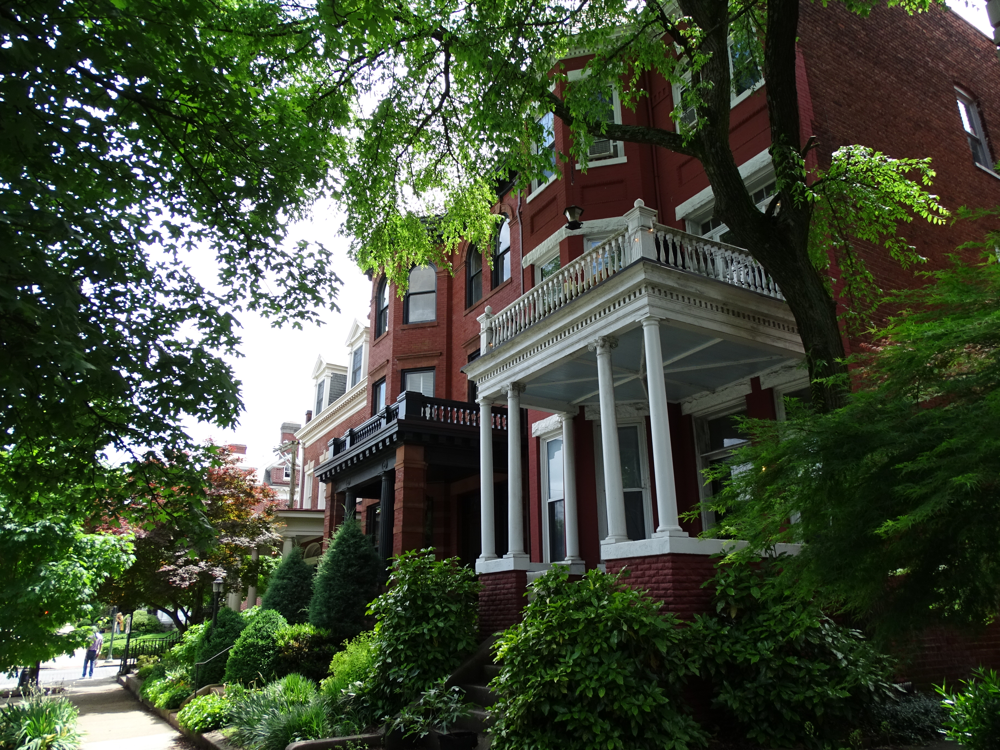

## БРИФ. Постановка цели и задач.

**Цель** - разработать модель, которая позволила бы агентству недвижимости обойти конкурентов по скорости и качеству сделок.  

**Задачи:**

* очистить данные от выбросов и мусора;
* провести расведовательный анализ;
* построить несколько моделей и выбрать демонстрирующую лучший результат;
* разработать небольшой веб-сервис, принимающий данные об объекте, возвращающих прогноз стоимости.

<p><span id="TOC"></span></p>

## ОГЛАВЛЕНИЕ
<p> <a href="#1-подгрузка-данных-и-необходимых-библиотек">1. ПОДГРУЗКА ДАННЫХ И НЕОБХОДИМЫХ БИБЛИОТЕК</a></p>
<p> <a href="#2-знакомство-с-данными">2. ЗНАКОМСТВО С ДАННЫМИ</a></p>
<p> <a href="#3-очистка-данных">3. ОЧИСТКА ДАННЫХ</a></p>
<p> <a href="#4-разведывательный-анализ-данных">4. РАЗВЕДЫВАТЕЛЬНЫЙ АНАЛИЗ ДАННЫХ</a></p>
<p> <a href="#5-создание-модели">5. СОЗДАНИЕ МОДЕЛЕЙ С ПОДБОРОМ ГИПЕРПАРАМЕТРОВ, ВЫБОР НАИЛУЧШЕЙ МОДЕЛИ</a></p>
<p> <a href="#6-продакт">6. ПРОДАКТ</a></p>

<p><span id="#1"></span></p>

## 1. ПОДГРУЗКА ДАННЫХ И НЕОБХОДИМЫХ БИБЛИОТЕК

In [56]:
import numpy as np
import pandas as pd

import category_encoders as ce
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import MinMaxScaler, RobustScaler

from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV

from sklearn import feature_selection
from sklearn.preprocessing import PolynomialFeatures

from sklearn.linear_model import LinearRegression
from sklearn.linear_model import ElasticNetCV
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import GradientBoostingRegressor
from catboost import CatBoostRegressor

import sklearn.metrics as metrics

import re
from itertools import chain

from geopy.geocoders import Nominatim
from geopy.exc import GeocoderTimedOut, GeocoderUnavailable
from geopy.exc import GeocoderServiceError

from scipy import stats
import statsmodels.api as sm

import pickle


import matplotlib
import matplotlib.pyplot as plt 
import seaborn as sns 

%matplotlib inline
matplotlib.style.use('ggplot')

In [57]:
data_initial = pd.read_csv('housing_data.csv')
data = data_initial.copy()

<p> <a href="#TOC"><kbd>&uarr;</kbd> Назад к оглавлению</a></p>

<p> <a href="#1-подгрузка-данных-и-необходимых-библиотек"><kbd>&uarr;</kbd> в начало раздела 1. ПОДГРУЗКА ДАННЫХ И НЕОБХОДИМЫХ БИБЛИОТЕК</a></p>

<p><span id="#2"></span></p>

## 2. ЗНАКОМСТВО С ДАННЫМИ

In [58]:
# Вывод первых трёх строк
data.head(3)

,status,private pool,propertyType,street,baths,homeFacts,fireplace,city,schools,sqft,zipcode,beds,state,stories,mls-id,PrivatePool,MlsId,target
0,Active,NaN,Single Family Home,240 Heather Ln,3.5,"{'atAGlanceFacts': [{'factValue': '2019', 'fac...",Gas Logs,Southern Pines,"[{'rating': ['4', '4', '7', 'NR', '4', '7', 'N...",2900,28387,4,NC,NaN,NaN,NaN,611019,"$418,000"
1,for sale,NaN,single-family home,12911 E Heroy Ave,3 Baths,"{'atAGlanceFacts': [{'factValue': '2019', 'fac...",NaN,Spokane Valley,"[{'rating': ['4/10', 'None/10', '4/10'], 'data...","1,947 sqft",99216,3 Beds,WA,2.0,NaN,NaN,201916904,"$310,000"
2,for sale,NaN,single-family home,2005 Westridge Rd,2 Baths,"{'atAGlanceFacts': [{'factValue': '1961', 'fac...",yes,Los Angeles,"[{'rating': ['8/10', '4/10', '8/10'], 'data': ...","3,000 sqft",90049,3 Beds,CA,1.0,NaN,yes,FR19221027,"$2,895,000"


In [59]:
# Общая информация
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 377185 entries, 0 to 377184
Data columns (total 18 columns):
 #   Column        Non-Null Count   Dtype 
---  ------        --------------   ----- 
 0   status        337267 non-null  object
 1   private pool  4181 non-null    object
 2   propertyType  342452 non-null  object
 3   street        377183 non-null  object
 4   baths         270847 non-null  object
 5   homeFacts     377185 non-null  object
 6   fireplace     103114 non-null  object
 7   city          377151 non-null  object
 8   schools       377185 non-null  object
 9   sqft          336608 non-null  object
 10  zipcode       377185 non-null  object
 11  beds          285903 non-null  object
 12  state         377185 non-null  object
 13  stories       226469 non-null  object
 14  mls-id        24942 non-null   object
 15  PrivatePool   40311 non-null   object
 16  MlsId         310305 non-null  object
 17  target        374704 non-null  object
dtypes: object(18)
memory usa

**Описание данных:**  
<span style="color:#184f80"><kbd>&rarr;</kbd></span> <span style=background-color:#D3D3D3>'status'</span> — статус продажи;  
<span style="color:#184f80"><kbd>&rarr;</kbd></span> <span style=background-color:#D3D3D3>'private pool'</span> и <span style=background-color:#D3D3D3>'PrivatePool'</span> — наличие собственного бассейна;  
<span style="color:#184f80"><kbd>&rarr;</kbd></span> <span style=background-color:#D3D3D3>'propertyType'</span> — тип объекта недвижимости;  
<span style="color:#184f80"><kbd>&rarr;</kbd></span> <span style=background-color:#D3D3D3>'street'</span> — адрес объекта;  
<span style="color:#184f80"><kbd>&rarr;</kbd></span> <span style=background-color:#D3D3D3>'baths'</span> — количество ванных комнат;  
<span style="color:#184f80"><kbd>&rarr;</kbd></span> <span style=background-color:#D3D3D3>'homeFacts'</span> — сведения о строительстве объекта (содержит несколько типов сведений, влияющих на оценку объекта);  
<span style="color:#184f80"><kbd>&rarr;</kbd></span> <span style=background-color:#D3D3D3>'fireplace'</span> — наличие камина;  
<span style="color:#184f80"><kbd>&rarr;</kbd></span> <span style=background-color:#D3D3D3>'city'</span> — город;  
<span style="color:#184f80"><kbd>&rarr;</kbd></span> <span style=background-color:#D3D3D3>'schools'</span> — сведения о школах в районе;  
<span style="color:#184f80"><kbd>&rarr;</kbd></span> <span style=background-color:#D3D3D3>'sqft'</span> — площадь в футах;  
<span style="color:#184f80"><kbd>&rarr;</kbd></span> <span style=background-color:#D3D3D3>'zipcode'</span> — почтовый индекс;  
<span style="color:#184f80"><kbd>&rarr;</kbd></span> <span style=background-color:#D3D3D3>'beds'</span> — количество спален;  
<span style="color:#184f80"><kbd>&rarr;</kbd></span> <span style=background-color:#D3D3D3>'state'</span> — штат;  
<span style="color:#184f80"><kbd>&rarr;</kbd></span> <span style=background-color:#D3D3D3>'stories'</span> — количество этажей;  
<span style="color:#184f80"><kbd>&rarr;</kbd></span> <span style=background-color:#D3D3D3>'mls-id'</span> и <span style=background-color:#D3D3D3>'MlsId'</span> — идентификатор MLS (Multiple Listing Service, система мультилистинга);  
<span style="color:#184f80"><kbd>&rarr;</kbd></span> <span style=background-color:#D3D3D3>'target'</span> — цена объекта недвижимости (**целевой признак, который необходимо спрогнозировать**).

#### Важные сведения о данных:

1. Признаки <span style=background-color:#D3D3D3>'homeFacts'</span> и <span style=background-color:#D3D3D3>'schools'</span> представляют собой словари и содержат несколько типов сведений. Необходимо десериализовать содержимое этих признаков. Если в нём есть полезные данные, необходимо создать из них новые признаки.

2. Типы жилья (может пригодиться при обработке признака <span style=background-color:#D3D3D3>propertyType</span>): 
    * **apartment** — съёмная квартира (нельзя купить); 
    * **condo** — кондоминиум (можно купить); 
    * **co-op** — квартира в жилищном кооперативе;
    * **single-family (detached, tiny home)** — односемейный (отдельный, маленький) дом;
    * **townhome, townhouse** — таунхаус;

3. Основные характеристики  жилья (может пригодиться при
обработке признака <span style=background-color:#D3D3D3>propertyType</span>): 
    * **cape cod** — черепичная крыша, облицовка деревянным сайдингом, дверь в центре здания, окна по бокам, один-два этажа; 
    * **colonial home** — минимум два этажа, симметрия, лестница в центре здания, строгий внешний вид; 
    * **contemporary** — чистые, простые линии, нейтральные цвета, натуральные текстуры;
    * **cottage** — небольшая уютная веранда, небольшие жилые помещения;
    * **craftsman** — деревянные элементы ручной работы, выступающие балки, большие колонны;
    * **Greek revival** — большие белые колонны, украшения в греческом стиле, нарядный вход;
    * **farmhouse** — прямоугольная планировка, большое крыльцо, амбарная крыша;
    * **French country** — влияние прованса, облицовка камнем, состаренный вид;
    * **Mediterranean** — белая штукатурка, дерево и камень в тёплых тонах, черепичные крыши, элементы испанских и итальянских вилл;
    * **midcentury modern** — сочетание плавных природных и строгих геометрических линий, гладкость, лаконичность, большие окна;
    * **ranch** — один этаж, низкая крыша, открытые жилые помещения, задний двор;
    * **split-level** — жилые помещения разделены короткими лестничными пролётами;
    * **Tudor** — деревянные балки, каменная кладка, асимметричная крутая двускатная крыша;
    * **Victorian (Queen Anne Houses)** — два-три и более этажей, богатый декор, крутая двускатная крыша, небольшие башенки, яркий фасад;
    * **European Houses style** — кирпич или камень, высокая крутая крыша, высокие окна, часто со ставнями, традиционные декоративные детали (фронтоны, замковые камни);
    * **log home** — деревянный дом.

4. Некоторые жаргонные сокращения — для исправления дублирования (может пригодиться при обработке признака <span style=background-color:#D3D3D3>propertyType</span>):
    * **manufactured home (house)** = **mobile** = **prefab** = **modular**; 
    * **mobile** = **mo2 le** = **mo2le**; 
    * **cabin** = **ca2 n** = **ca2n**; 
    * **midcentury** = **mid century** = **mid-century**;
    * **single family** = **single-family home**.
    
5. Некоторые термины, используемые в сфере купли-продажи недвижимости:
    * **status** — статус, состояние. 
    * **estate** — объект недвижимости. 
    * **foreclosed** (**foreclosure**) — «лишён права выкупа». *Это процесс, когда недвижимость переходит к кредитору из-за неуплаты ипотеки заёмщиком. Продажа foreclosure-недвижимости отличается от традиционных продаж.*
    * **pre foreclosure** (**pre foreclosure auction**) — «до выкупа», «аукцион до выкупа».
    * **under contract showing** (**under contract show**, **under contract**, **active under contract**) — предложение о покупке уже сделано, но не принято продавцом окончательно, и недвижимость продолжают показывать другим потенциальным покупателям.
    * **under contract backups**, **active backup**, **backup contract** — предложение о покупке уже сделано и принято продавцом, однако он открыт для резервных предложений. 
    * **contingency** — дополнительные обстоятельства (критерии, которым должен соответствовать продавец/покупатель до завершения сделки).
    * **contingency contract** — контракт на случай возникновения дополнительных обстоятельств.
    * **active contingency** — сделка уже практически состоялась, однако продавцу/покупателю для её завершения необходимо выполнить какие-то условия.
    * **insp inspection contingency** — ситуация, когда покупатель может официально проинспектировать объект недвижимости в определённый период времени.
    * **pending escape clause** — договор, предполагающий свободный выход сторон из него.
    * **pending backup wanted** — договор уже заключен, однако продавец хочет продолжать показывать недвижимость другим потенциальным покупателям и принимать резервные предложения.
    * **pending take backups** — условие, предполагающее, что продавец может принимать резерные предложения, если сделка с текущим покупателем не состоится.
    * **pending continue show** — договор уже заключен, однако продавец хочет продолжать показывать недвижимость другим потенциальным покупателям на случай, если текущая сделка не состоится.
    * **pending inspection** — «в ожидании инспекции».
    * **due diligence period** — период, в течение которого покупатель имеет право проинспектировать недвижимость и изучить всю важную для заключения сделки информацию.
    * **activated** — «активен», открыт для покупки.
    * **active with contract** — продавец уже принял предложение о покупке, однако сделка ещё не закрыта.
    * **active with offer** — продавец принял предложение о покупке, однако ищет резервные предложения на случай, если сделка с текущим покупателем не состоится.
    * **active auction**, **auction active**, **auction** — продажа недвижимости с помощью аукциона.
    * **cooling-off period** — период, в течение которого покупатель может расторгнуть договор после завершения сделки.

<p> <a href="#TOC"><kbd>&uarr;</kbd> Назад к оглавлению</a></p>

<p> <a href="#2-знакомство-с-данными"><kbd>&uarr;</kbd> в начало раздела 2. ЗНАКОМСТВО С ДАННЫМИ</a></p>

## 3. ОЧИСТКА ДАННЫХ

### 3.1. Удаление неинформативных столбцов и обработка дублирующихся наблюдений

In [60]:
# Проверка на дублирующиеся наблюдения в данных:
data_duplicated = data.duplicated().sum()
print(f'В данных содержится {data_duplicated} дубликатов')

В данных содержится 50 дубликатов


In [61]:
# общщее колличество пропусков по каждому признаку
empty_cells = data.isnull().sum()
empty_cells

status           39918
private pool    373004
propertyType     34733
street               2
baths           106338
homeFacts            0
fireplace       274071
city                34
schools              0
sqft             40577
zipcode              0
beds             91282
state                0
stories         150716
mls-id          352243
PrivatePool     336874
MlsId            66880
target            2481
dtype: int64

In [62]:
# Пропуски в признаках в процентном соотношении:
for col_name, missings_count in empty_cells.items():
    if missings_count > 0:
        percentage = (missings_count / len(data)) * 100
        print(col_name, round(percentage,2),'%')

status 10.58 %
private pool 98.89 %
propertyType 9.21 %
street 0.0 %
baths 28.19 %
fireplace 72.66 %
city 0.01 %
sqft 10.76 %
beds 24.2 %
stories 39.96 %
mls-id 93.39 %
PrivatePool 89.31 %
MlsId 17.73 %
target 0.66 %


#### 3.1.1. Обработка идентификаторов системы мультилистинга MLS

Столбцы с идентификаторами MLS (Multiple Listing Service, система мультилистинга) не только неинформативны, но и не совпадают, несмотря на общую суть. Это может приводить к скрытому дублированию. Поэтому, прежде чем удалять дубликаты, целесообразно удалить неинформативные признаки, а затем ещё раз проверить количество дублирующихся наблюдений без них.

In [63]:
# Удаление неинформативных признаков
data.drop(['mls-id','MlsId'],axis=1, inplace=True)
data_duplicated_311 = data.duplicated().sum()
print(f'В данных содержится {data_duplicated_311} дубликат(ов)')

В данных содержится 141 дубликат(ов)


Гипотеза подтвердилась: 141 вместо 50. После обработки всех признаков необходимо ещё раз удалить дубликаты.

In [64]:
# Удаление дублирующихся наблюдений
data = data.drop_duplicates(ignore_index=True)
d311_len = data.shape[0]
print(f'После удаления дубликатов в данных содержится {d311_len} наблюдений')

После удаления дубликатов в данных содержится 377044 наблюдений


#### 3.1.2. Признаки PrivatePool и private pool

Ситуация с бассейнами немного сложнее: существует 2 столбца одинаковых по смыслу, но различных по содержанию.

In [65]:
print('Уникальные значения в параметре private pool:', data['private pool'].unique())
print('Уникальные значения в параметре PrivatePool:', data['PrivatePool'].unique())
print(' ')

# Оценка количества расхождений
print('Количество совпадающих и несовпадающих значений:')
data['PrivatePool'].isin(data['private pool']).value_counts()

Уникальные значения в параметре private pool: [nan 'Yes']
Уникальные значения в параметре PrivatePool: [nan 'yes' 'Yes']
 
Количество совпадающих и несовпадающих значений:


PrivatePool
True     348252
False     28792
Name: count, dtype: int64

In [66]:
# Информация о несовпадающих значениях
mask_pool = np.invert(data['PrivatePool'].isin(data['private pool']))
pool_difference = data[mask_pool][['PrivatePool','private pool']]
pool_difference

,PrivatePool,private pool
2,yes,NaN
12,yes,NaN
19,yes,NaN
43,yes,NaN
67,yes,NaN
...,...,...
377016,yes,NaN
377026,yes,NaN
377027,yes,NaN
377030,yes,NaN


Единственно верного решения проблемы с этими признаками нет, поскольку неизвестна точная причина расхождений.
Возникают следующие предположения:

* база создана из нескольких баз и, поскольку данные о бассейнах сильно не совпадали, а причины несовпадения установить невозможно, оба признака было решено сохранить;
* пропуск можно интерпретировать двояко - как отсутствие бассейна и как ошибку: бассейн есть, но информацию о нём не внесли в базу;
* возможно, столбец <span style=background-color:#D3D3D3>'PrivatePool'</span>, расположенный ближе к концу таблицы был добавлен позже, чем <span style=background-color:#D3D3D3>'private pool'</span> и он содержит более актуальную информацию (в нём существенно меньше пропусков).

Если первое предоположение верно, то данные о наличии/отсутствии бассейна недостоверны. Очевидно, что бассейн - дорогой объект и его наличие и состояние должно как-то влиять на цену недвижимости. Таким образом, использование недостоверных данных негативно повлияет на качество созданной модели.

Второе и третье предположение помогают объяснить случаи, когда у одних и тех же объектов в <span style=background-color:#D3D3D3>'PrivatePool'</span> есть утверждение о наличии бассейна, а в предположительно более старом признаке <span style=background-color:#D3D3D3>'private pool'</span> - нет. В то же время отсутствие инфо о бассейне в "новом" признаке при том, что в "старом" указано, что бассейн есть, не является опровержением наличия бассейна (возможна ошибка).

С этими допущениями целесообразно создать новый признак <span style=background-color:#D3D3D3>'Private pool'</span> путём объединения двух существующих с условием: если хотя бы в одном из существующих признаков есть указание на наличие бассейна, в новом признаке оно сохраняется.

In [67]:
# Приведение значений признаков к одному стандарту:
data['PrivatePool'] = data['PrivatePool'].replace('yes', 'Yes')
# Объединение признаков с заполнением пропусков:
data['Private pool'] = data['private pool'].combine_first(data['PrivatePool'])
# Удаление исходных столбцов:
data = data.drop(['private pool','PrivatePool'], axis=1)
# Пропуски в новом признаке Private pool:
print('Количество пропусков в признаке Private pool:', data['Private pool'].isnull().sum())

Количество пропусков в признаке Private pool: 332553


In [68]:
# Булевое кодирование: False вместо пропусков
data['Private pool'] = data['Private pool'].fillna(False)
# Булевое кодирование: True вместо Yes
data['Private pool'] = data['Private pool'].replace('Yes', True)

In [69]:
print(f'Количество пропусков: {data["Private pool"].isna().sum()}\n'
      f'Количество уникальных значений: {data["Private pool"].nunique()}')
print('\nЗначения признака:')
data['Private pool'].value_counts()

Количество пропусков: 0
Количество уникальных значений: 2

Значения признака:


Private pool
False    332553
True      44491
Name: count, dtype: int64

#### 3.1.3. Обобщённая предобработка наблюдений с большим количеством пропусков

Объекты, содержащие более 50% пропусков целесообразно сразу удалить.

In [70]:
# Удаление объкетов, у которых менее 8 заполненных признаков из 15
data = data.dropna(thresh=8)
d313_len = data.shape[0]

print(f'После удаления полупустых строк в данных содержится {d313_len} наблюдений')

После удаления полупустых строк в данных содержится 377008 наблюдений


In [71]:
data_31 = data.copy()

Теперь можно переходить к последовательной обработке признаков.

#### 3.2. Признак status

In [72]:
print(f'Количество пропусков: {data_31.status.isna().sum()}\n'
      f'Количество уникальных значений: {data_31.status.nunique()}')
print('\nЗначения признака:')
data_31.status.value_counts()

Количество пропусков: 39880
Количество уникальных значений: 159

Значения признака:


status
for sale                156052
Active                  105125
For sale                 43464
foreclosure               6425
New construction          5474
                         ...  
Contingent   No Show         1
Coming soon: Oct 24.         1
Coming soon: Oct 21.         1
Coming soon: Nov 14.         1
Coming soon: Dec 23.         1
Name: count, Length: 159, dtype: int64

In [73]:
print(f"Уникальные значения в алфавитном порядке:\n \n{data_31['status'].sort_values().unique()}")

Уникальные значения в алфавитном порядке:
 
[' / auction' 'A Active' 'Accepted Offer' 'Accepting backups' 'Active'
 'Active - Auction' 'Active - Contingent' 'Active Backup'
 'Active Contingency' 'Active Contingent' 'Active Option'
 'Active Option Contract' 'Active Under Contract'
 'Active With Contingencies' 'Active With Offer' 'Active with Contract'
 'Active/Contingent' 'Apartment for rent' 'Auction' 'Auction - Active'
 'Back On Market' 'Back on Market' 'Backup' 'Backup Contract' 'C'
 'C Continue Show' 'CT Insp - Inspection Contingency' 'Closed'
 'Coming soon: Dec 1.' 'Coming soon: Dec 10.' 'Coming soon: Dec 11.'
 'Coming soon: Dec 12.' 'Coming soon: Dec 13.' 'Coming soon: Dec 14.'
 'Coming soon: Dec 15.' 'Coming soon: Dec 16.' 'Coming soon: Dec 18.'
 'Coming soon: Dec 2.' 'Coming soon: Dec 20.' 'Coming soon: Dec 23.'
 'Coming soon: Dec 24.' 'Coming soon: Dec 25.' 'Coming soon: Dec 27.'
 'Coming soon: Dec 3.' 'Coming soon: Dec 4.' 'Coming soon: Dec 5.'
 'Coming soon: Dec 6.' 'Coming s

In [74]:
# Нормализация регистра
data_31['status'] = data_31['status'].str.lower()

In [75]:
# Унификация при помощи словаря:
status_synonyms = {
  
    
    'auction':[' / auction', 'a active', 'active', 'active - auction', 'auction - active', 'auction'],
    
    'closed':['c', 'closed'],  
    
    'Coming soon: October':['coming soon: oct 21.', 'coming soon: oct 24.', 'coming soon: oct 29.',
            'coming soon: oct 30.'], 
    
    'Coming soon: November':['coming soon: nov 11.', 'coming soon: nov 12.', 'coming soon: nov 13.',
            'coming soon: nov 14.', 'coming soon: nov 17.', 'coming soon: nov 19.', 'coming soon: nov 21.',
            'coming soon: nov 22.', 'coming soon: nov 23.', 'coming soon: nov 25.', 'coming soon: nov 26.',
            'coming soon: nov 27.', 'coming soon: nov 28.', 'coming soon: nov 29.', 'coming soon: nov 30.',
            'coming soon: nov 5.', 'coming soon: nov 8.'],
    
    'Coming soon: December':['coming soon: dec 1.', 'coming soon: dec 9.' 'coming soon: dec 10.',
            'coming soon: dec 11.', 'coming soon: dec 12.', 'coming soon: dec 13.', 'coming soon: dec 14.',
            'coming soon: dec 15.', 'coming soon: dec 16.', 'coming soon: dec 18.', 'coming soon: dec 2.',
            'coming soon: dec 20.', 'coming soon: dec 23.', 'coming soon: dec 24.', 'coming soon: dec 25.',
            'coming soon: dec 27.', 'coming soon: dec 3.', 'coming soon: dec 4.', 'coming soon: dec 5.',
            'coming soon: dec 6.', 'coming soon: dec 7.', 'coming soon: dec 9.'],
    
    'Contingent': ['contingent', 'contingent - sale of home','contingent take backup',
            'contingent   show', 'active with contingencies'],
    
    'New construction':['new construction', 'new'],
    
    'Pending':['option pending' ,  'pending (do not show)', 'pending ab',
            'pending fe', 'pending offer approval',  'pending sh', 'pending w/escape clause', 'p', 'pending',
            'pending   continue to show', 'pending - continue to show', 'pending continue to show',
            'pending, continue to show', 'pending   continue to show   financing', 'pending with contingencies',
            'pending w/ cont.', 'pending inspection', 'pending w/insp finance', 'pending in', 'pi', 
            'pending sale', 'p pending sale', 'pending taking backups', 'pending - paking backups',
            'pending bring backup', 'pending - backup offer requested','pending backups wanted',
            'pending take backups', 'pending w/backup wanted', 'pending - taking backups', 'backup'],
    
    'Pre-foreclosure':[ 'pre-foreclosure', 'pf'],
    
    'Sold': ['sold: $285,000', 'sold: $15,000'],
    
    'Under Contract':['under contract', 'under contract', 'u under contract'],
    
    'Under Contract Backups':['under contract backups', 'under contract taking back up offers',
              'under contract w/ bckp', 'under contract   showing', 'uc continue to show',
              'under contract - show',  'under contract show']
      
    }

# Функция для замены значений на ключи
def status_rename(value):
  for key, val in status_synonyms.items():
    if value in val:
      return key
  return value

# Замена с помощью функции:
data_31['status'] = data_31['status'].apply(status_rename)
# Заполнение пропусков уже существующим значением - No info
data_31['status'] = data_31['status'].fillna('No info')

In [76]:
# Проверка по итогам обработки признака:
print(f'Количество пропусков: {data_31.status.isna().sum()}\n'
      f'Количество уникальных значений: {data_31.status.nunique()}')
print('\nЗначения признака:')
data_31.status.value_counts()

Количество пропусков: 0
Количество уникальных значений: 66

Значения признака:


status
for sale                 199518
auction                  107078
No info                   39880
Pending                    6870
foreclosure                6768
                          ...  
conting accpt backups         1
lease/purchase                1
contract                      1
temporary active              1
reactivated                   1
Name: count, Length: 66, dtype: int64

### 3.3. Признак propertyType

In [77]:
data_33 = data_31.copy()

In [78]:
print(f'Количество пропусков: {data_33.propertyType.isna().sum()}\n'
      f'Количество уникальных значений: {data_33.propertyType.nunique()}')
print('\nЗначения признака:')
data_33.propertyType.value_counts()

Количество пропусков: 34689
Количество уникальных значений: 1280

Значения признака:


propertyType
single-family home                                             92199
Single Family                                                  62867
Single Family Home                                             31691
condo                                                          25964
lot/land                                                       20520
                                                               ...  
Custom, Elevated, Other                                            1
Contemporary, Farmhouse                                            1
2 Stories, Traditional, Mediterranean, Texas Hill Country          1
1 Story, Contemporary, Traditional, Mediterranean                  1
Bilevel, Converted Dwelling, Loft with Bedrooms, Condo/Unit        1
Name: count, Length: 1280, dtype: int64

In [79]:
# Нормализация регистра
data_33.propertyType = data_33.propertyType.str.lower()

In [80]:
data_33.propertyType = data_33.propertyType \
.str.replace('single-family home','single family') \
.str.replace('single family home','single family') \
.str.replace('yes','Other') \
.str.replace('unknown','Other')

In [81]:
print('Количество уникальных значений после преобразования:{}'.format(data_33['propertyType'].nunique()))

Количество уникальных значений после преобразования:1269


In [82]:
# Объединение по первому слову:
data_33.propertyType = data_33.propertyType.str.replace('^victorian.*','victorian', regex=True)
data_33.propertyType = data_33.propertyType.str.replace('^other.*','Other', regex=True)

In [83]:
# Разделение по строкам:
data_33['propertyType'] = data_33['propertyType'].str.split(',').str[0]

In [84]:
# Унификация оставшихся значений с помощью словаря:
synonyms = {
    'single_family_home': ['single family', '1 story', '2 story', 'detached', 'one story',
            '1 story traditional', 'single detached', 'singlefamilyresidence', 'single wide',
            'single-wide mobile with land', 'two story', 'one level unit',
            '1 1/2 story', 'single wide mh', 'one story traditional'],
    
    'multi_family_home': ['multi-family', 'multi-family home', 'duplex', 'triplex', 'fourplex',
            'multi_level', 'multi family', '2-story'],
    
    'condo': ['condo','2 unit condo', 'coop', 'cooperative', 'condo/townhome/row home/co-op', 'condo/townhome',
            'condominium', 'condo/unit', 'apartment/condo/townhouse', 'co-op', '2 story condo',
            'high rise'],
    
    'townhouse': ['townhouse', 'townhome style', 'townhouse-interior', 'townhouse-end unit'],
    
    'apartment': ['apartment', 'condominium (single level)', 'high-rise', 'mid-rise', 'low-rise (1-3 stories)',
            'Flats', 'studio'],
    
    'land': ['lot/land', 'land'],
    
    'mobile_home': ['mobile/manufactured', 'mobile / manufactured', 'manufactured house', 'mfd/mobile home',
            'mobile home', 'manufactured home', 'manufactured double-wide', 'manufactured single-wide',
            'mobile home 1 story', 'mobile manu - double wide'],
    
    'miscellaneous': ['miscellaneous'],
    
    'ranch': ['ranch', '1 story/ranch', 'rancher'],
    
    'modern': ['contemporary', 'contemporary/modern', 'modern', 'mid-century modern', 'modern farmhouse',
            'modernist'],
    
    'historical': ['historical', 'designated historical home', 'historical/conservation district',
            'historic/older', 'historic vintage', 'historic'],
    
    'other': ['Other', 'english', 'urban contemporary', 'other style', 'florida', 'farms/ranches',
            'carriage house', 'country english', 'straight thru', 'less than 4 floors', 'bungalow',
            'custom', 'arts & crafts', 'tudor', 'new build 2019', 'split foyer', 'cottage', 'cottage/camp',
            'garden home', 'farm/ranch', 'farm/ranch house', 'farm house', 'hi ranch', 'attached duplex',
            'farmhouse', 'houseboat', 'ground floor', 'victorian', '3 story', '3+ stories',
            'santa barbara/tuscan', 'old style', 'modular/prefab', 'post and beam', 'manuf/mobile',
            'multiple occupancy', 'attached', 'hawaiian plantation', 'forest garden home',
            '1 1/2 story with basement', 'split-entry', 'texas hill country', 'lake house',
            '1 story with basement', 'hi-rise', 'coastal beach home', 'historical', 'key west/coastal',
            'loft/balcony', 'english manor', 'mid-rise (4-7 stories)', 'mid-level', 'new englander',
            'residential (<1 acre)', 'ranch','residential (1+ acre)', 'split', 'split level',
            'split (4 level)', 'split (5+ level)', 'urban', 'patio', 'patio home', 'penthouse', 'manor',
            'victorian/federal', 'coastal', 'coastal contemporary', 'coastal ii', 'coastal modern',
            'coastal two story', 'mountain contemporary', 'key west', 'high ranch', 'end unit']
}


# Функция для замены значений на ключи:
def prop_type__rename(value):
    for key, syn_val in synonyms.items():
        if value in syn_val:
            return key
    return 'other'

# Замена с помощью функции:
data_33['propertyType']= data_33['propertyType'].apply(prop_type__rename)


In [85]:
# Проверка по итогам обработки признака:
print(f'Количество пропусков: {data_33.propertyType.isna().sum()}\n'
      f'Количество уникальных значений: {data_33.propertyType.nunique()}')
print('\nЗначения признака:')
data_33.propertyType.value_counts()

Количество пропусков: 0
Количество уникальных значений: 12

Значения признака:


propertyType
single_family_home    195850
condo                  56954
other                  51540
land                   31419
townhouse              18543
multi_family_home      12348
mobile_home             3551
modern                  3252
ranch                   2083
apartment               1308
miscellaneous             96
historical                64
Name: count, dtype: int64

### 3.4. Признак street

In [86]:
data_34 = data_33.copy()

In [87]:
print(f'Количество пропусков: {data_34.street.isna().sum()}\n'
      f'Количество уникальных значений: {data_34.street.nunique()}')
print('\nЗначения признака:')
data_34.street.value_counts()

Количество пропусков: 2
Количество уникальных значений: 337041

Значения признака:


street
Address Not Disclosed                           672
Undisclosed Address                             512
(undisclosed Address)                           390
Address Not Available                           174
Unknown Address                                  72
                                               ... 
1369 N Downing St #3                              1
100 Zambrano Rd                                   1
2846 Grasmere View Pkwy                           1
Buildable plan: Plan 1417 Northeast Crossing      1
5983 Midcrown Dr                                  1
Name: count, Length: 337041, dtype: int64

In [88]:
# Нормализация регистра
data_34['street'] = data_34['street'].str.lower()

In [89]:
# Унификация пустых и скрытых значений с помощью словаря:
synonyms = {
    'unknown address':['address not disclosed', 'undisclosed address', '(undisclosed address)',
                       'address not available', 'unknown address']
}

# Функция для замены значений на ключи:
def address_unification(value):
    for key, val in synonyms.items():
        if value in val:
            return key
    return value
# Замена с помощью функции
data_34['street'] = data_34['street'].apply(address_unification)    
# Замена пропусков       
data_34['street'] = data_34['street'].fillna('unknown address')        


In [90]:
# Проверка по итогам обработки признака:
print(f'Количество пропусков: {data_34.street.isna().sum()}\n'
      f'Количество уникальных значений: {data_34.street.nunique()}')
print('\nЗначения признака:')
data_34.street.value_counts()

Количество пропусков: 0
Количество уникальных значений: 336227

Значения признака:


street
unknown address           1822
2103 e state hwy 21         56
11305 gulf fwy              53
17030 youngblood rd.        38
9470 lancaster rd. sw       32
                          ... 
2935 67th way n              1
512 pine tree ct             1
5900 nw 44th st #702         1
460 w canfield st #312       1
5983 midcrown dr             1
Name: count, Length: 336227, dtype: int64

### 3.5. Признак baths

In [91]:
data_35 = data_34.copy()

In [92]:
print(f'Количество пропусков: {data_35.baths.isna().sum()}\n'
      f'Количество уникальных значений: {data_35.baths.nunique()}')
print('\nЗначения признака:')
data_35.baths.value_counts()

Количество пропусков: 106226
Количество уникальных значений: 229

Значения признака:


baths
2 Baths       52458
3 Baths       35503
2             20439
2.0           16574
4 Baths       14763
              ...  
4.75 Baths        1
5.25 Baths        1
41.0              1
1.8 Baths         1
44.0              1
Name: count, Length: 229, dtype: int64

В данных очень много пропусков - почти треть, а часть значений выглядит не вполне понятно или неправдоподобно. С практической точки зрения количество ванн - важный показатель, влияющий на цену (с математической - ещё предстоит посчитать), поэтому очевидно, что такое низкое качество данных негативно скажется на качестве модели. Некоторыми преобразованиями можно попытаться снизить негативный эффект.

In [93]:
# Нормализация регистра
data_35['baths'] = data_35['baths'].str.lower()

# Удаление текста
data_35.loc[:,'baths'] = data_35.loc[:,'baths'].str.replace('[a-z]','',regex=True)

# Информация для преобразований и словаря:
data_35.baths.unique()

array(['3.5', '3 ', '2 ', '8 ', nan, '2', '3', ': 2', '1,750', '4 ',
       ': 5', '1,000', '7 ', '2.0', '3.0', ': 1', '4.0', '2.1 ', '2.5 ',
       '1', ': 3', '4.5', '6 ', ': 4', '5', '2,500', '5.5 ', '1.0', '5 ',
       '1.5', '4', '~', '2.5', '4,000', '3.5 ', '2,000', '3,000', '8.0',
       '1 ', '0', '5.0', '1,500', '7.0', '1,250', '9 ', '2,250', '6.0',
       '12 ', '5.5', '3,500', '1.5 ', '2,750', ': 6', '4.5 ', '750',
       '5.5+', '6', '10 ', ': 19', '10.0', '2.5+', '8', '7.5+', ': 10',
       '0 / 0', '. . ', '4.5+', '18 ', '-- ', ': 7', '7', '18', '3.5+',
       '1.5+', '11 ', '5,000', '1.75 ', '9', '12.0', '1.1 ', '6.5', ': 8',
       '10', '19 ', ': 9', '16 ', '13 ', ': 13', '14', '9.0', '8.5+',
       '12', ': 12', '17', ': 241', '16.0', '10.5+', '6.5+', '6.5 ',
       '14 ', '7,500+', '7.5', '11.0', '20 ', '11', '40 ',
       '1-0 / 1-0 / 1', '14.0', '2.75 ', '24 ', '22.0', '0.00', '2.25 ',
       '3.1 ', '3.25 ', '—', '13', '22', '32', '7.5 ', '18.0', ': 11',
       '1

In [94]:
# Общие преобразования признака:
data_35.baths = data_35.baths.fillna('unknown')
data_35.baths = data_35.baths \
.str.replace(' ','', regex=True) \
.str.replace(':','', regex=True) \
.str.replace('~','unknown', regex=True) \
.str.replace('\.\.','unknown', regex=True) \
.str.replace('--','unknown', regex=True) \
.str.replace('—','unknown', regex=True) \
.str.replace('^\s*$','unknown', regex=True) \
.str.replace('1-0/1-0/1','unknown', regex=True) \
.str.replace('116/116/116','unknown', regex=True) \
.str.replace('3-1/2-2','unknown', regex=True) \
.str.replace('1/1/1/1','unknown', regex=True) \
.str.replace('2-1/2-1/1-1/1-1','unknown', regex=True) \
.str.replace('1/1-0/1-0/1-0','unknown', regex=True) \
.str.replace('.*unknown.*','unknown', regex=True) \
.str.replace('1-2','unknown', regex=True) \
.str.replace('^0.0+','0', regex=True)

In [95]:
# Унификация значений, где через запятую указана предположительно площадь и "+", с помощью словаря:
synonyms = {
    '1':['1,000', '1,500', '1,250', '750', '1,750'],
    '1.5':['1.5+'],
    '2':['2,500', '2,000', '2,250', '2,750'],
    '2.5':['2.5+'],
    '3':['3,500', '3,000', ],
    '3.5':['3.5+'],
    '4.0':['4,000'],
    '4.5':['4.5+'],
    '5.0':['5,000'],
    '5.5':['5.5+',],
    '6.5':['6.5+',],
    '7':['7,500+'],
    '7.5':['7.5+'],
    '8.5':['8.5+'],
    '10.5':['10.5+'],
    '11.5':['11.5+'],
    '12.5':['12.5+'],
    '14.5':['14.5+'],
    '9.5':['9.5+']

}

# Функция для замены значений на ключи:
def baths_unification(value):
    for key, val in synonyms.items():
        if value in val:
            return key
    return value
# Замена с помощью функции
data_35['baths'] = data_35['baths'].apply(baths_unification)     

In [96]:
# Преобразование для устранения дублирований типа "1" и "1.0" и последующих вычислений:
data_35['baths'] = data_35['baths'].apply(lambda x: pd.to_numeric(x, errors='coerce') )

In [97]:
print(f'Количество пропусков: {data_35.baths.isna().sum()}\n'
      f'Количество уникальных значений: {data_35.baths.nunique()}')
print('\nЗначения признака:')
data_35.baths.value_counts()

Количество пропусков: 107733
Количество уникальных значений: 82

Значения признака:


baths
2.0     106796
3.0      67326
4.0      26331
1.0      23159
2.5      12879
         ...  
3.3          1
76.0         1
14.5         1
5.2          1
68.0         1
Name: count, Length: 82, dtype: int64

Хотя в США принято указывать количество ванных с дробной частью (например, за отсутствие какого либо устройства в ванной "балл" снижают с единицы на какую-то дробную часть), для исследовательских целей этот признак лучше округлить, а пропуски обозначить как 0.

Значения, которые выглядят неправдоподобными, будут рассмотрены в рамках EDA и сопоставлены с другими признаками.

In [98]:
# Округление до целого:
data_35['baths'] = data_35['baths'].astype(float).round()
# Замена NaN на 0
data_35['baths'] = data_35['baths'].fillna(0)

In [99]:
# Проверка по итогам обработки признака:
print(f'Количество пропусков: {data_35.baths.isna().sum()}\n'
      f'Количество уникальных значений: {data_35.baths.nunique()}')
print('\nЗначения признака:')
data_35.baths.value_counts()

Количество пропусков: 0
Количество уникальных значений: 47

Значения признака:


baths
2.0      121996
0.0      111646
3.0       67388
4.0       33395
1.0       23186
5.0        9455
6.0        5017
7.0        2098
8.0        1255
9.0         546
10.0        348
11.0        187
12.0        141
13.0         74
16.0         52
14.0         46
18.0         32
15.0         28
24.0         17
20.0         16
22.0         10
17.0         10
26.0          8
23.0          8
30.0          6
27.0          5
40.0          4
21.0          4
44.0          3
32.0          3
19.0          3
36.0          3
28.0          2
34.0          2
29.0          2
241.0         1
55.0          1
25.0          1
43.0          1
41.0          1
76.0          1
35.0          1
64.0          1
39.0          1
42.0          1
60.0          1
68.0          1
Name: count, dtype: int64

### 3.6. Признак homeFacts

In [100]:
print(f'Количество пропусков: {data_35.homeFacts.isna().sum()}\n'
      f'Количество уникальных значений: {data_35.homeFacts.nunique()}')
print('\nЗначения признака:')
data_35.homeFacts.value_counts()

Количество пропусков: 0
Количество уникальных значений: 321006

Значения признака:


homeFacts
{'atAGlanceFacts': [{'factValue': '', 'factLabel': 'Year built'}, {'factValue': '', 'factLabel': 'Remodeled year'}, {'factValue': '', 'factLabel': 'Heating'}, {'factValue': '', 'factLabel': 'Cooling'}, {'factValue': '', 'factLabel': 'Parking'}, {'factValue': '—', 'factLabel': 'lotsize'}, {'factValue': None, 'factLabel': 'Price/sqft'}]}                                                     7144
{'atAGlanceFacts': [{'factValue': None, 'factLabel': 'Year built'}, {'factValue': None, 'factLabel': 'Remodeled year'}, {'factValue': None, 'factLabel': 'Heating'}, {'factValue': None, 'factLabel': 'Cooling'}, {'factValue': None, 'factLabel': 'Parking'}, {'factValue': None, 'factLabel': 'lotsize'}, {'factValue': None, 'factLabel': 'Price/sqft'}]}                                          3532
{'atAGlanceFacts': [{'factValue': '', 'factLabel': 'Year built'}, {'factValue': '', 'factLabel': 'Remodeled year'}, {'factValue': '', 'factLabel': 'Heating'}, {'factValue': '', 'factLabel': 'Cooling'}

Это интересный признак: каждый его объект содержит вложенные словари, внутри которых спрятаны другие потенциально важные признаки. Чтобы их проанализировать, небходимо распаковать и добавить их в качестве признаков в основной датафрейм.

In [101]:
# Ключи вложенных словарей:
fact_values = data_35.homeFacts.str.findall(r"\bfactValue': ([\s\S]+?), 'factLabel\b")
# Ключи вложенных словарей:
fact_labels = data_35.homeFacts.str.findall(r"\bfactLabel': ([\s\S]+?)[}\b]")

# Список ключей вложенных словарей, подготовленный для добавления в основной датафрейм:
Labes_list = ','.join(fact_labels[0]).replace("'","").split(',')
Labes_list

['Year built',
 'Remodeled year',
 'Heating',
 'Cooling',
 'Parking',
 'lotsize',
 'Price/sqft']

In [102]:
data_36 = data_35.copy()

In [103]:
# Добавление новых признаков в основной датафрейм:
for i, val in enumerate(Labes_list):
    data_36[val]=fact_values.apply(lambda x: x[i])

In [104]:
# Признак Homefacts далее не потребуется, можно его удалить:
data_36 = data_36.drop('homeFacts', axis=1)

In [105]:
data_36.head(3)

,status,propertyType,street,baths,fireplace,city,schools,sqft,zipcode,beds,...,stories,target,Private pool,Year built,Remodeled year,Heating,Cooling,Parking,lotsize,Price/sqft
0,auction,single_family_home,240 heather ln,4.0,Gas Logs,Southern Pines,"[{'rating': ['4', '4', '7', 'NR', '4', '7', 'N...",2900,28387,4,...,NaN,"$418,000",False,'2019','',"'Central A/C, Heat Pump'",'','',None,'$144'
1,for sale,single_family_home,12911 e heroy ave,3.0,NaN,Spokane Valley,"[{'rating': ['4/10', 'None/10', '4/10'], 'data...","1,947 sqft",99216,3 Beds,...,2.0,"$310,000",False,'2019','','','','','5828 sqft','$159/sqft'
2,for sale,single_family_home,2005 westridge rd,2.0,yes,Los Angeles,"[{'rating': ['8/10', '4/10', '8/10'], 'data': ...","3,000 sqft",90049,3 Beds,...,1.0,"$2,895,000",True,'1961','1967','Forced Air','Central','Attached Garage',"'8,626 sqft'",'$965/sqft'


### 3.6.1. Признак Year built

In [106]:
print(f'Количество пропусков: {data_36["Year built"].isna().sum()}\n'
      f'Количество уникальных значений: {data_36["Year built"].nunique()}')
print('\nЗначения признака:')
data_36['Year built'].sort_values().unique()

Количество пропусков: 0
Количество уникальных значений: 231

Значения признака:


array(["''", "'1'", "'1019'", "'1057'", "'1060'", "'1208'", "'1700'",
       "'1703'", "'1735'", "'1740'", "'1750'", "'1780'", "'1788'",
       "'1790'", "'1794'", "'1795'", "'1796'", "'1799'", "'1800'",
       "'1802'", "'1803'", "'1804'", "'1805'", "'1807'", "'1808'",
       "'1809'", "'1810'", "'1811'", "'1812'", "'1815'", "'1816'",
       "'1817'", "'1818'", "'1820'", "'1822'", "'1823'", "'1824'",
       "'1825'", "'1828'", "'1829'", "'1830'", "'1831'", "'1832'",
       "'1834'", "'1835'", "'1836'", "'1840'", "'1842'", "'1843'",
       "'1844'", "'1845'", "'1846'", "'1847'", "'1848'", "'1850'",
       "'1851'", "'1852'", "'1853'", "'1854'", "'1855'", "'1856'",
       "'1857'", "'1858'", "'1859'", "'1860'", "'1861'", "'1862'",
       "'1863'", "'1864'", "'1865'", "'1866'", "'1867'", "'1868'",
       "'1869'", "'1870'", "'1871'", "'1872'", "'1873'", "'1874'",
       "'1875'", "'1876'", "'1877'", "'1878'", "'1879'", "'1880'",
       "'1881'", "'1882'", "'1883'", "'1884'", "'1885'", "'

In [107]:
# Общие преобразования:
data_36['Year built'] = data_36['Year built'].str.replace("'",'', regex=True)
# Замена неизвестных значений:
data_36['Year built'] = data_36['Year built'].str.replace('^\s*$','None', regex=True)

In [108]:
# Потенциальные опечатки
data_36.loc[data_36['Year built']=='1019','Year built'] = '1919'
data_36.loc[data_36['Year built']=='1057','Year built'] = '1957'
data_36.loc[data_36['Year built']=='1060','Year built'] = '1960'
data_36.loc[data_36['Year built']=='1','Year built'] = 'None'
data_36.loc[data_36['Year built']=='1208','Year built'] = 'None'
data_36.loc[data_36['Year built']=='2025','Year built'] = 'None'
data_36.loc[data_36['Year built']=='559990649990','Year built'] = 'None'
data_36.loc[data_36['Year built']=='No Data','Year built'] = 'None'

In [109]:
# Преобразование для последующих вычислений:
data_36['Year built'] = data_36['Year built'].apply(lambda x: pd.to_numeric(x, downcast='float', errors='coerce') )

In [110]:
data_361 = data_36.copy()

In [111]:
# Cоздание нового признака с периодами, в которые были построены дома
data_361['Built in a period'] = data_361['Year built']

In [112]:
# Преобразование значения признака

years_before1800 = range(0, 1801)
years1801_1850 = range(1801, 1851)
years1851_1900 = range(1851, 1901)
years1901_1920 = range(1901, 1921)
years1921_1930 = range(1921, 1931)
years1931_1940 = range(1931, 1941)
years1941_1950 = range(1941, 1951)
years1951_1960 = range(1951, 1961)
years1961_1970 = range(1961, 1971)
years1971_1980 = range(1971, 1981)
years1981_1990 = range(1981, 1991)
years1991_2000 = range(1991, 2001)
years2001_2010 = range(2001, 2011)
years2011_2020 = range(2011, 2021)
years2021_2030 = range(2021, 2031)

data_361['Built in a period'] = data_361['Built in a period']\
    .apply(lambda x: x if x not in years_before1800 else '18 Century or older')
data_361['Built in a period'] = data_361['Built in a period']\
    .apply(lambda x: x if x not in years1801_1850 else '1st half of 19 Century')
data_361['Built in a period'] = data_361['Built in a period']\
    .apply(lambda x: x if x not in years1851_1900 else '2nd half of 19 Century')
data_361['Built in a period'] = data_361['Built in a period']\
    .apply(lambda x: x if x not in years1901_1920 else 'Early 1900-s')
data_361['Built in a period'] = data_361['Built in a period']\
    .apply(lambda x: x if x not in years1921_1930 else '1920-s')
data_361['Built in a period'] = data_361['Built in a period']\
    .apply(lambda x: x if x not in years1931_1940 else '1930-s')
data_361['Built in a period'] = data_361['Built in a period']\
    .apply(lambda x: x if x not in years1941_1950 else '1940-s')
data_361['Built in a period'] = data_361['Built in a period']\
    .apply(lambda x: x if x not in years1951_1960 else '1950-s')
data_361['Built in a period'] = data_361['Built in a period']\
    .apply(lambda x: x if x not in years1961_1970 else '1960-s')
data_361['Built in a period'] = data_361['Built in a period']\
    .apply(lambda x: x if x not in years1971_1980 else '1970-s')
data_361['Built in a period'] = data_361['Built in a period']\
    .apply(lambda x: x if x not in years1981_1990 else '1980-s')
data_361['Built in a period'] = data_361['Built in a period']\
    .apply(lambda x: x if x not in years1991_2000 else '1990-s')
data_361['Built in a period'] = data_361['Built in a period']\
    .apply(lambda x: x if x not in years2001_2010 else 'Early 2000-s')
data_361['Built in a period'] = data_361['Built in a period']\
    .apply(lambda x: x if x not in years2011_2020 else '2010-s')
data_361['Built in a period'] = data_361['Built in a period']\
    .apply(lambda x: x if x not in years2021_2030 else '2020-s')

In [113]:
# Замена пропусков       
data_361['Built in a period'] = data_361['Built in a period'].fillna('unknown year')  

In [114]:
# Проверка по итогам обработки признака:
print(f'Количество пропусков: {data_361["Built in a period"].isna().sum()}\n'
      f'Количество уникальных значений: {data_361["Built in a period"].nunique()}')
print('\nЗначения признака:')
data_361['Built in a period'].value_counts()

Количество пропусков: 0
Количество уникальных значений: 16

Значения признака:


Built in a period
2010-s                    64141
unknown year              63448
Early 2000-s              50364
1970-s                    29477
1980-s                    28520
1990-s                    26935
1950-s                    26871
1960-s                    24370
1920-s                    16379
1940-s                    15856
Early 1900-s              14770
1930-s                     9398
2nd half of 19 Century     6153
1st half of 19 Century      205
2020-s                       70
18 Century or older          51
Name: count, dtype: int64

Признак <span style=background-color:#D3D3D3>'Built in a period'</span> создан для замены <span style=background-color:#D3D3D3>'Year_built'</span>, можно удалить <span style=background-color:#D3D3D3>'Year_built'</span>.

In [115]:
data_361 = data_361.drop('Year built',axis=1)

### 3.6.2. Признак Remodeled year

In [116]:
print(f'Количество пропусков: {data_361["Remodeled year"].isna().sum()}\n'
      f'Количество уникальных значений: {data_361["Remodeled year"].nunique()}')
print('\nЗначения признака:')
data_361['Remodeled year'].sort_values().unique()

Количество пропусков: 0
Количество уникальных значений: 155

Значения признака:


array(["''", "'0'", "'1111'", "'1738'", "'1800'", "'1845'", "'1846'",
       "'1853'", "'1862'", "'1869'", "'1870'", "'1874'", "'1876'",
       "'1877'", "'1880'", "'1883'", "'1884'", "'1885'", "'1886'",
       "'1887'", "'1888'", "'1889'", "'1890'", "'1891'", "'1892'",
       "'1893'", "'1894'", "'1895'", "'1896'", "'1897'", "'1898'",
       "'1899'", "'1900'", "'1901'", "'1902'", "'1903'", "'1904'",
       "'1905'", "'1906'", "'1907'", "'1908'", "'1909'", "'1910'",
       "'1911'", "'1912'", "'1913'", "'1914'", "'1915'", "'1916'",
       "'1917'", "'1918'", "'1919'", "'1920'", "'1921'", "'1922'",
       "'1923'", "'1924'", "'1925'", "'1926'", "'1927'", "'1928'",
       "'1929'", "'1930'", "'1931'", "'1932'", "'1933'", "'1934'",
       "'1935'", "'1936'", "'1937'", "'1938'", "'1939'", "'1940'",
       "'1941'", "'1942'", "'1943'", "'1944'", "'1945'", "'1946'",
       "'1947'", "'1948'", "'1949'", "'1950'", "'1951'", "'1952'",
       "'1953'", "'1954'", "'1955'", "'1956'", "'1957'", "'

In [117]:
data_362 = data_361.copy()

In [118]:
# Общие преобразования:
data_362['Remodeled year'] = data_362['Remodeled year'].str.replace("'",'', regex=True)
# Замена неизвестных значений:
data_362['Remodeled year'] = data_362['Remodeled year'].str.replace('^\s*$','None', regex=True)

In [119]:
data_362['Remodeled year'].value_counts().head(25)

Remodeled year
None    225935
2006      5538
2005      4817
2007      4387
2008      3796
2004      3371
1980      3339
1970      3153
2000      3068
2003      2828
1985      2819
2002      2716
1975      2694
1990      2657
1965      2619
1983      2454
2001      2442
1995      2375
1988      2351
1962      2236
1978      2206
1981      2133
1998      2128
1960      2084
1999      2073
Name: count, dtype: int64

In [120]:
Remodeled_completeness = data_362[data_362['Remodeled year'].isin(["''", "'0'", "'1111'",'None'])].shape[0]/data_362.shape[0]*100
print(f'Доля пропущенных и недостоверных значений составляет {round(Remodeled_completeness, 2)} %.')

Доля пропущенных и недостоверных значений составляет 59.93 %.


Похоже, что дальнейшую обработку этого признака проводить нецелесообразно: пропуски составляют 60%, а среди значений, похожих на реальные, есть такие давние годы, которые равносильны пропускам.

Дело в том, что Remodeled не равно Renovated. То есть ошибочно было бы предполагать, что это означает ремонт. Remodeled - это реконструкция, изменение характеристик, перестройка. Актуальные характеристики жилья можно видеть в других признаках, а год, когда они изменились, в данном случае неважен.

Допустим, есть объект **A**, который построен в середине XX века и реконструирован (Remodeled) в 2020 году. С одной стороны, можно предположить, что после недавней реконструкции он выглядит как новенький и уже не похож на своих ровесников (и скорее всего за счёт этого отличается по цене). А есть другой объект B такого же возраста. Но при этом неизвестно, в каком состоянии сейчас находится объект **B** (в графе Remodeled у него пропуск). При этом если он не был реконструирован (Remodeled), это не значит, что он например не был отремонтирован (Renovated) одновременно или ещё позже и выглядит, лучше, чем **A**, но по базовым техническим характеристикам не изменился. То есть о состоянии жилья этот признак нам ничего не говорит.

Таким образом, этот признак едва ли добавит модели качества, поэтому его следует удалить

In [121]:
data_362['Remodeled year']
data_362 = data_362.drop('Remodeled year', axis=1)

### 3.6.3. Признак Heating

In [122]:
print(f'Количество пропусков: {data_362["Heating"].isna().sum()}\n'
      f'Количество уникальных значений: {data_362["Heating"].nunique()}')
print('\nЗначения признака:')
data_362['Heating'].value_counts()

Количество пропусков: 0
Количество уникальных значений: 1985

Значения признака:


Heating
''                                                                105636
'Forced Air'                                                       82804
'Forced air'                                                       51503
'Other'                                                            29622
'Electric'                                                         10210
                                                                   ...  
'Natural Gas, Space Heater'                                            1
'Exhaust Fans'                                                         1
'Central, Exhaust Fans, Natural Gas, Zoned'                            1
'BR Closet-Electric - new'                                             1
'Baseboard, Hot Water, Programmable Thermostat, Radiant Floor'         1
Name: count, Length: 1985, dtype: int64

In [123]:
data_363 = data_362.copy()

In [124]:
# Нормализация регистра и удаление кавычек:
data_363['Heating'] = data_363['Heating'].str.replace("'",'', regex=True)
data_363['Heating'] = data_363['Heating'].str.lower()

In [125]:
data_363['Heating'] = data_363['Heating'].str.replace('^\s*$','None', regex=True)

In [126]:
data_363['Heating'].value_counts()

Heating
forced air                                                      134307
None                                                            105636
other                                                            29622
electric                                                         10216
gas                                                               9295
                                                                 ...  
zoned heating, wall unit heating, forced air heating                 1
baseboard, spacewallunit                                             1
hot air, stove-pellet                                                1
natural gas, space heater                                            1
baseboard, hot water, programmable thermostat, radiant floor         1
Name: count, Length: 1918, dtype: int64

В данном признаке чуть менее трети - пропуски, кроме того не учитывается климат.

Чтобы этот признак положительно сказался на качестве модели, необходимо тщательно разделить множество существующих значений на несколько (например 15) крупных групп. Кроме того, модель должна учитывать наличие и тип отопления в комплексе с информацией о климатическом районе, где находится тот или иной объект недвижимости (такой признак можно создать с помощью инфо о почтовом индексе). Предполагаю, что в северных и глубоко континентальных штатах коэффициент этого нового признака будет выше, чем в южных (например, в большом доме на севере газовое отопление обходится намного дешевле электрического - это различие точно должно играть роль в определении цены недвижимости, а на юге ради нескольких прохладных дней в году такое отопление просто не нужно; может быть там есть электрическое, но о нём возможно даже не упоминают при продаже дома).

В рамках данной работы заниматься настолько глубокой проработкой я не имею возможности, а без неё признак <span style=background-color:#D3D3D3>'Heating'</span> будет негативно влиять на качество модели, его целесообразно удалить.

In [127]:
data_363 = data_363.drop('Heating', axis=1)

### 3.6.4. Признак Cooling

In [128]:
print(f'Количество пропусков: {data_363["Cooling"].isna().sum()}\n'
      f'Количество уникальных значений: {data_363["Cooling"].nunique()}')
print('\nЗначения признака:')
data_363['Cooling'].value_counts()

Количество пропусков: 0
Количество уникальных значений: 1446

Значения признака:


Cooling
'Central'                                                                158742
''                                                                       120272
'Central Air'                                                             14384
'No Data'                                                                 10615
'Has Cooling'                                                              9730
                                                                          ...  
'Central Gas, Propane, Zoned'                                                 1
'Other (See Remarks), Panel/Floor/Wall, Window Unit'                          1
'Multi Units, Zoned Cooling'                                                  1
'Central Air, g-Energy Star HVAC, Gas Hot Air/Furnace, Multizone A/C'         1
'Central A/C (Gas), Central Heat (Gas), Heat Pump'                            1
Name: count, Length: 1446, dtype: int64

In [129]:
data_364 = data_363.copy()

In [130]:

data_364['Cooling'] = data_364['Cooling'].str.replace("'",'', regex=True)
data_364['Cooling'] = data_364['Cooling'].str.lower()

In [131]:
data_364['Cooling'].unique()

array(['', 'central', 'central air', ...,
       'central air, electric hot air, gas (hot air), heat pump for a/c, heat pump for heat, multi-zone a/c, multi-zone heat, natural gas',
       '90%+ high efficiency, ductless hp-mini split, tankless water heater',
       'central a/c (gas), central heat (gas), heat pump'], dtype=object)

В признаке содержится информация о различных типах кондиционирования, очень большое количество уникальных значений. Также в признаке содержится большое число пропусков (ещё больше, чем в <span style=background-color:#D3D3D3>'Heating'</span>).

Поскольку все системы кондиционирования электрические, стоимость эксплуатации у них примерно сопоставима друг с другом (в отличие от систем отопления), считаю целесообразным сохранить этот признак и даже не делить его на категории, а булево закодировать по следующему правилу: любая система кондиционирования = True, в ином случае False (включая случаи, когда видимо вследствие ошибки речь явно не о кондиционировании).

In [132]:
data_364['Cooling'] = data_364['Cooling'].\
    apply(lambda x: True if x not in ['', 'no data', 'multi-zone heat', 'heat pump for heat', 'central heating',
        'central gas', 'natural gas', 'gas (hot air)', 'tankless water heater', 'None', 'none'] else False)

In [133]:
data_364['Cooling'].value_counts()

Cooling
True     228751
False    148257
Name: count, dtype: int64

### 3.6.5. Признак Parking

In [134]:
print(f'Количество пропусков: {data_364["Parking"].isna().sum()}\n'
      f'Количество уникальных значений: {data_364["Parking"].nunique()}')
print('\nЗначения признака:')
data_364['Parking'].value_counts()

Количество пропусков: 0
Количество уникальных значений: 3347

Значения признака:


Parking
''                                                                                                                                    171721
'Attached Garage'                                                                                                                      70748
'2 spaces'                                                                                                                             28061
'1 space'                                                                                                                              14252
'No Data'                                                                                                                              13332
                                                                                                                                       ...  
'Assigned, Parking Space Conveys, Paved Parking, Private, Parking Lot, On Street'                                                          1
'Boat

In [135]:
data_365 = data_364.copy()

In [136]:
# Нормализация регистра и удаление кавычек
data_365['Parking'] = data_365['Parking'].str.replace("'",'', regex=True)
data_365['Parking'] = data_365['Parking'].str.lower()

In [137]:
data_365['Parking'].nunique()

3320

В признаке содержится информация о типах парковок, гаражей, и площадок, с указанием количества парковочных мест и без. Поскольку в признаке содержится слишком много пропусков (почти половина), трудоёмкий процесс по созданию категорий из этих данных не сулит значительного роста качества модели.

На основании изложенного считаю целесообразным булево закодировать этот признак по следующему правилу: любая парковка/гараж = True, в ином случае False (включая некоторые посторонние значения).

In [138]:
data_365['Parking'] = data_365['Parking'].\
    apply(lambda x: True if x not in ['', 'no data', 'None', 'none','0', '888'] else False)

In [139]:
data_365['Parking'].value_counts()

Parking
False    192320
True     184688
Name: count, dtype: int64

### 3.6.6.  Признак lotsize

In [140]:
print(f'Количество пропусков: {data_365["lotsize"].isna().sum()}\n'
      f'Количество уникальных значений: {data_365["lotsize"].nunique()}')
print('\nЗначения признака:')
data_365['lotsize'].value_counts()

Количество пропусков: 0
Количество уникальных значений: 37393

Значения признака:


lotsize
''                  33055
None                28346
'—'                 25221
'No Data'            5329
'-- sqft lot'        3819
                    ...  
'5,695 Sq. Ft.'         1
'6,816 Sq. Ft.'         1
'8,762 sqft'            1
'9,212 sqft lot'        1
'7,084 sqft lot'        1
Name: count, Length: 37393, dtype: int64

In [141]:
data_366 = data_365.copy()

In [142]:
def replace_substring( column, to_delete, to_paste ):
    func = lambda x: x.replace(to_delete,to_paste) if pd.notna(x) else x
    data_366[column] = data_366[column].apply(func)

In [143]:
# Единицы измерения
digits_list = ['0','1','2','3','4','5','6','7','8','9',"'"]
def notDecimal(str):
    return "".join(c for c in str if c not in digits_list)

replace_substring('lotsize', '-', '')
data_366['lotsize'] = data_366['lotsize'].apply( lambda x: 'None' if x == "''" else x)

data_366['temporary'] = data_366['lotsize'].apply(notDecimal)
data_366['temporary'] = data_366['temporary'].str.lower()

print('всего уникальных значений в колонке temporary:', data_366['temporary'].nunique())
data_366['temporary'].unique()

всего уникальных значений в колонке temporary: 22


array(['none', ' sqft', ', sqft', ', sq. ft.', '', '. acres',
       ', sqft lot', '. acres lot', '—', 'no data', ' sqft lot', ' acres',
       ' acre', ' sq. ft.', '.', ' acre lot', ' acres lot', ',. acres',
       ',', ', acres', ', acres lot', ',. acres lot'], dtype=object)

In [144]:
# Функция по замене значения в случае если оно совпадает с указанным:
def replace_string(column, what_coinsides, to_paste):
    func = lambda x: x if pd.isna(x) else to_paste if x == what_coinsides else x
    data_366[column] = data_366[column].apply(func) 

In [145]:
# Функция по замене значения в случае если найдена подстрока:
def replace_if_found( column, to_find, to_paste ):
    func = lambda x: x if pd.isna(x) else to_paste if x.find(to_find) != -1 else x
    data_366[column] = data_366[column].apply(func)

In [146]:
# Необходимые значения - только акры и квадратные футы
replace_if_found('temporary', 'acre', 'acre')
replace_if_found('temporary', 'sqft', 'sqft')
replace_string('temporary','', 'sqft')

func = lambda x: 'not' if x not in ['sqft', 'acre'] else x
data_366['temporary'] = data_366['temporary'].apply(func)

print('всего уникальных значений:', data_366['temporary'].unique())

всего уникальных значений: ['not' 'sqft' 'acre']


In [147]:
# Функция для удаления из строки всех символов, кроме точки и цифр:
decimal_symbols = ['0','1','2','3','4','5','6','7','8','9','.']
def onlyDecimal(str):
    if pd.isnull(str):
        return np.nan;
    result = "".join(c for c in str if c in decimal_symbols)
    if result == '':
        result = np.nan
    return result

In [148]:
# функция для перевода признака lotsize в формат float
def func(row):
    if row['temporary'] == 'not':
        return '0'
    else:
        return onlyDecimal(row['lotsize'])

data_366['lotsize'] = data_366.apply(func, axis = 1)

# Применение функции:
data_366['lotsize'] = data_366['lotsize'].astype(float)

In [149]:
# Функция для перевода акров в квадратные футы
def func(row):
    if row['temporary'] == 'acre':
        return row['lotsize']*43560
    else:
        return row['lotsize']

# Применение функции:
data_366['lotsize'] = data_366.apply(func, axis = 1)

In [150]:
# Удаление временного признака:
data_366.drop('temporary', axis = 1, inplace=True)

In [151]:
data_366["lotsize"] = data_366["lotsize"].fillna(0)

In [152]:
print(f'Количество пропусков: {data_366["lotsize"].isna().sum()}\n'
      f'Количество уникальных значений: {data_366["lotsize"].nunique()}')
print('\nЗначения признака:')
data_366['lotsize'].value_counts()

Количество пропусков: 0
Количество уникальных значений: 18450

Значения признака:


lotsize
0.0           123947
10890.0         3498
11325.6         3418
12196.8         2840
11761.2         2711
               ...  
2429776.8          1
481.0              1
16680.0            1
27589597.2         1
2871.0             1
Name: count, Length: 18450, dtype: int64

Почти 124000 объектов в сумме не имеют участка или их площадь не указана. Можно предположить, что часть из них - это жильё в многоквартирных домах. Но для остальных объектов - в основном отдельных домов площадь участка очень важна. Жаль проделанной работы, но в сумме всё это даёт мусор в признаке, от которого, к сожалению придётся избавиться.

In [153]:
data_366 = data_366.drop('lotsize', axis=1)

### 3.6.7. Признак Price/sqft

Признак <span style=background-color:#D3D3D3>'Price/sqft'</span> показывает отношение цены объекта к его площади.
Это яркий пример потенциальной утечки: модель не должна обучаться на таких данных. Этот признак необходимо удалить.

In [154]:
data_366 = data_366.drop('Price/sqft', axis=1)

### 3.7. Признак fireplace

In [155]:
print(f'Количество пропусков: {data_366["fireplace"].isna().sum()}\n'
      f'Количество уникальных значений: {data_366["fireplace"].nunique()}')
print('\nЗначения признака:')
data_366['fireplace'].value_counts()

Количество пропусков: 273898
Количество уникальных значений: 1652

Значения признака:


fireplace
yes                                                                     50353
Yes                                                                     20856
1                                                                       14543
2                                                                        2432
Not Applicable                                                           1993
                                                                        ...  
Free-standing, Insert, Wood                                                 1
Wood Burning, Attached Fireplace Doors/Screen, Electric, Gas Starter        1
One, Living Room                                                            1
FAMILYRM, Great Room, Living Room                                           1
Ceiling Fan, SMAPL, Utility Connection, Walk-In Closets                     1
Name: count, Length: 1652, dtype: int64

In [156]:
data_37 = data_366.copy()

In [157]:
# Нормализация регистра
data_37['fireplace'] = data_37['fireplace'].str.lower()

Несмотря на то, что 2/3 наблюдений содержат пропуски, предполагаю, что этот признак можно оставить с допущением: пропуски означают отсутствие камина. Таким образом, не углубляясь в 1653 уникальных значения, этот признак целесообразно булево закодировать по следующему правилу: наличие любого вида камина = True, в противном случае False.

In [158]:
# Преобразование признака
data_37['fireplace'] = data_37['fireplace']\
    .apply(lambda x: True if x not in ['', 'no data', 'None', 'none', '0', 'not applicable', 'no']
        and not pd.isna(x) else False)

In [159]:
data_37['fireplace'].value_counts()

fireplace
False    276451
True     100557
Name: count, dtype: int64

### 3.8. Признак city

In [160]:
print(f'Количество пропусков: {data_37["city"].isna().sum()}\n'
      f'Количество уникальных значений: {data_37["city"].nunique()}')
print('\nЗначения признака:')
data_37['city'].value_counts()

Количество пропусков: 32
Количество уникальных значений: 2026

Значения признака:


city
Houston            24437
San Antonio        15591
Miami              15524
Jacksonville       10011
Dallas              8854
                   ...  
New Albany             1
Los Altos Hills        1
Lake worth             1
Lisle                  1
Blue Springs           1
Name: count, Length: 2026, dtype: int64

In [161]:
data_38 = data_37.copy()

In [162]:
# Объекты с пропусками в признаке city
mask38 = data[data_38['city'].isna()]
mask38

,status,propertyType,street,baths,homeFacts,fireplace,city,schools,sqft,zipcode,beds,state,stories,target,Private pool
7830,Active,Single Family Home,13155 W Highway 316,2,"{'atAGlanceFacts': [{'factValue': '2000', 'fac...",NaN,NaN,"[{'rating': ['1', '4', '3', '3', '6', '6'], 'd...",1016,32686,1,FL,2,"$1,495,000",False
21529,Active,Land,SE 117th Ter,NaN,"{'atAGlanceFacts': [{'factValue': '', 'factLab...",NaN,NaN,"[{'rating': [], 'data': {'Distance': [], 'Grad...",0,32668,NaN,FL,NaN,"$49,900",False
26466,Active,Land,Blk 4 N America Lareedo Rd Lot 8,NaN,"{'atAGlanceFacts': [{'factValue': '', 'factLab...",NaN,NaN,"[{'rating': [], 'data': {'Distance': [], 'Grad...",0,78045,NaN,TX,NaN,"$417,718",False
60989,Active,Land,Ocala,NaN,"{'atAGlanceFacts': [{'factValue': '', 'factLab...",NaN,NaN,"[{'rating': [], 'data': {'Distance': [], 'Grad...",0,34474,NaN,FL,NaN,"$31,334",False
81507,Active,Land,Unditermined Unditermined,NaN,"{'atAGlanceFacts': [{'factValue': '', 'factLab...",NaN,NaN,"[{'rating': [], 'data': {'Distance': [], 'Grad...",0,34432,NaN,FL,NaN,"$28,000",False
122330,Active,Land,Sw149 Ter,NaN,"{'atAGlanceFacts': [{'factValue': '', 'factLab...",NaN,NaN,"[{'rating': [], 'data': {'Distance': [], 'Grad...",0,34481,NaN,FL,NaN,"$18,000",False
123474,Active,Land,26484 Deer Rd,NaN,"{'atAGlanceFacts': [{'factValue': '', 'factLab...",NaN,NaN,"[{'rating': ['6', '5', '7', '7', '2', '10', 'N...",0,33955,NaN,FL,NaN,"$4,000",False
130546,For sale,Single Family,20003 Mar Rojo Y Mar Egeo,Bathrooms: 6,"{'atAGlanceFacts': [{'factValue': '2000', 'fac...",NaN,NaN,"[{'rating': ['5/10', 'NA', '4/10'], 'data': {'...","Total interior livable area: 5,905 sqft",20003,5 bd,MA,NaN,"$1,650,000",True
131258,Active,Land,19212 Roosevelt,NaN,"{'atAGlanceFacts': [{'factValue': '', 'factLab...",NaN,NaN,"[{'rating': ['5', '4', '6', 'NR', '5', 'NR', '...",0,33954,NaN,FL,NaN,"$4,200",False
170319,Active,Single Family Home,2678 Calistoga Ave,7.5,"{'atAGlanceFacts': [{'factValue': '2015', 'fac...",NaN,NaN,"[{'rating': ['2', '4', '6', '4', '3', '10', 'N...",0,34741,7,FL,2,"$675,000",False


Возможно не оптимальным образом, вручную с помощью сайта https://zipcodes.org/us-zip-codes по индексам присвою значения пропущенным городам. Есть более разумные способы, но с ходу я их не помню, нужно разбираться, а здесь не так много ручной работы:

In [163]:
# Присвоение почтовых индексов:
data_38.loc[7830,'city'] = 'Reddick'
data_38.loc[21529,'city'] = 'Morriston'
data_38.loc[26466,'city'] = 'Laredo'
data_38.loc[60989,'city'] = 'Ocala'
data_38.loc[81507,'city'] = 'Dunnelon'
data_38.loc[122330,'city'] = 'Ocala'
data_38.loc[123474,'city'] = 'Punta Gorda'
data_38.loc[130546,'city'] = 'Washington DC'
data_38.loc[131258,'city'] = 'Port Charlotte'
data_38.loc[170319,'city'] = 'Kissimmee'
data_38.loc[171274,'city'] = 'Laredo'
data_38.loc[186758,'city'] = 'Ocala'
data_38.loc[199625,'city'] = 'Ocala'
data_38.loc[215040,'city'] = 'Silver Springs'
data_38.loc[221233,'city'] = 'Laredo'
data_38.loc[221822,'city'] = 'Laredo'
data_38.loc[262281,'city'] = 'Cleveland'
data_38.loc[270848,'city'] = 'Laredo'
data_38.loc[277381,'city'] = 'Reddick'
data_38.loc[278435,'city'] = 'Kissimmee'
data_38.loc[281938,'city'] = 'Kissimmee'
data_38.loc[304841,'city'] = 'Kissimmee'
data_38.loc[309169,'city'] = 'Kissimmee'
data_38.loc[312872,'city'] = 'Dunnelon'
data_38.loc[325677,'city'] = 'Punta Gorda'
data_38.loc[331068,'city'] = 'Ocklawaha'
data_38.loc[342229,'city'] = 'Laredo'
data_38.loc[346172,'city'] = 'Miami'
data_38.loc[355273,'city'] = 'Punta Gorda'
data_38.loc[358810,'city'] = 'Kissimmee'
data_38.loc[369946,'city'] = 'Houston'
data_38.loc[370373,'city'] = 'Ocklawaha'

In [164]:
print(f'Количество пропусков: {data_38["city"].isna().sum()}\n'
      f'Количество уникальных значений: {data_38["city"].nunique()}')

Количество пропусков: 0
Количество уникальных значений: 2028


В признаке <span style=background-color:#D3D3D3>'city'</span> немало мутных значений, но сложно удержаться и пройти мимо одного, который я выше обрабатывал вручную: zip-код и номер дома содержат одно и то же значение: 20003. Изначально я обработал его по почтовому индексу 20003, но затем решил проверить, верно ли это. 

In [165]:
data_38.loc[130546]

status                                                        for sale
propertyType                                        single_family_home
street                                       20003 mar rojo y mar egeo
baths                                                              6.0
fireplace                                                        False
city                                                     Washington DC
schools              [{'rating': ['5/10', 'NA', '4/10'], 'data': {'...
sqft                           Total interior livable area: 5,905 sqft
zipcode                                                          20003
beds                                                              5 bd
state                                                               MA
stories                                                            NaN
target                                                      $1,650,000
Private pool                                                      True
Coolin

По информации из признака <span style=background-color:#D3D3D3>'street'</span> этого объекта ещё можно найти архивное объявление о его продаже, и находится он конечно не в центре Вашингтона с zip-кодом 20003, а во Флориде (штат указан верно). При этом в признаке <span style=background-color:#D3D3D3>'street'</span> указано название этого объекта, а не улица. Точный адрес неизвестен, на сайте риэлтора указан только район в Майами, где находится этот объект. Теперь можно присвоить ему если не истинный индекс, то хотя бы какой-то по соседству в этом районе.

Помня о правиле машинного обучения "мусор на входе - мусор на выходе", всё более опасаюсь за качество будущей модели. Очевидно, что исследователь не в состоянии распространить такой подход, как к этому конкретному объекту, на весь датасет. А там есть немало подобных несоответствий.

In [166]:
data_38.loc[130546,'city'] = 'Miami'
data_38.loc[130546,'zipcode'] = '33157'

In [167]:
# Нормализация регистра
data_38['city'] = data_38['city'].str.lower()
print(f'Количество пропусков: {data_38["city"].isna().sum()}\n'
      f'Количество уникальных значений: {data_38["city"].nunique()}')

Количество пропусков: 0
Количество уникальных значений: 1910


### 3.9. Признак schools

In [168]:
print(f'Количество пропусков: {data_38["schools"].isna().sum()}\n'
      f'Количество уникальных значений: {data_38["schools"].nunique()}')
print('\nЗначения признака:')
data_38['schools'].value_counts()

Количество пропусков: 0
Количество уникальных значений: 297344

Значения признака:


schools
[{'rating': [], 'data': {'Distance': [], 'Grades': []}, 'name': []}]                                                                                                                                                                                                                                                                               4183
[{'rating': ['4/10', '5/10', '6/10'], 'data': {'Distance': ['39.69mi', '39.69mi', '39.69mi'], 'Grades': ['9-12', '6-8', 'PK-5']}, 'name': ['Fort Hancock High School', 'Fort Hancock Middle School', 'Benito Martinez Elementary School']}]                                                                                                         222
[{'rating': ['4/10', '6/10', '3/10'], 'data': {'Distance': ['3.62mi', '3.62mi', '3.62mi'], 'Grades': ['6-8', 'PK-5', '9-12']}, 'name': ['Horizon Middle School', 'Desert Hills Elementary School', 'Horizon High School']}]                                                                                     

Признак содержит данные в виде словарей о наименовании, рейтинге школы, расстоянии до школы и grades - сведения о том, по какой системе работает школа (K-6, K-12 и т.п.), является ли она начальной, средней или старшей, с какого по какой класс ребёнок может обучаться в данной школе.

Признак Grades скорее важен для конкретного покупателя, у которого есть дети определённого возраста, чем для исследователя больших данных. Его, как и название школы, учитывать не имеет смысла. 

Растояние до школы и ее рейтинг можно проанализировать, добавив к основному датафрейму.

In [169]:
data_39 = data_38.copy()

### 3.9.1. Признак school rating

In [170]:
# Функция для расчёта среднего рейтинга:
def rating_transform(rating):
    rating = rating[0].replace('/10', '')
    extracted_numbers = [float(num) for num in rating if num.isdigit()]
    average_rating = np.average(extracted_numbers) if extracted_numbers else -1
    return round(average_rating, 1)

# Создание переменной со средними рейтингам, пропуски заполнены -1, чтобы можно было их легко идентифицировать:
rating_mean = (
    data_39.schools.str.findall(r"\brating': ([\s\S]+?), 'data\b")
    .apply(lambda x: rating_transform(x))
)

In [171]:
# Создание признака school_rating: 
data_39['school rating'] = rating_mean

In [172]:
print(f'Количество пропусков: {data_39["school rating"].isna().sum()}\n'
      f'Количество уникальных значений: {data_39["school rating"].nunique()}')
print('\nЗначения признака:')
data_39['school rating'].value_counts()

Количество пропусков: 0
Количество уникальных значений: 80

Значения признака:


school rating
3.0    22811
4.0    22623
5.0    18822
6.0    16820
3.3    15671
       ...  
1.9       41
6.1       38
0.7       33
7.1       17
6.9        8
Name: count, Length: 80, dtype: int64

### 3.9.2. Признак school distance

In [173]:
# Извлечение расстояний до школы:
school_distance = data_39['schools'].str.findall(r"\bDistance': ([\s\S]+?), 'Grades\b") 
# Получение первого найденного значения из полученных списков:
school_distance = school_distance.apply(lambda x: x[0]) 
# Удаление всех буквенных символов:
school_distance = school_distance.str.replace('[a-zA-Z]','', regex=True) 
# Извлечение чисел:
school_distance = school_distance.str.findall(r'\b([0-9]+.[0-9]+)') 
# Преобразование значений списка в тип float:
school_distance = school_distance.apply(lambda x: [float(i) for i in x]) 
# Нахождение минимального значения в каждом списке s_distance, если длина списка = 0, возвращается -1
school_distance_min = school_distance.apply(lambda x: -1 if len(x)==0 else min(x)) 

In [174]:
# Создадие нового признака в основном датафрейме:
data_39['school distance'] = school_distance_min

In [175]:
print(f'Количество пропусков: {data_39["school distance"].isna().sum()}\n'
      f'Количество уникальных значений: {data_39["school distance"].nunique()}')
print('\nЗначения признака:')
data_39['school distance'].value_counts()

Количество пропусков: 0
Количество уникальных значений: 1541

Значения признака:


school distance
0.30     22478
0.40     20954
0.20     20283
0.50     18789
0.60     16058
         ...  
13.29        1
7.33         1
19.84        1
24.79        1
10.13        1
Name: count, Length: 1541, dtype: int64

In [176]:
# Удаление признака schools
data_39 = data_39.drop('schools', axis=1)

### 3.10. Признак sqft

In [177]:
print(f'Количество пропусков: {data_39["sqft"].isna().sum()}\n'
      f'Количество уникальных значений: {data_39["sqft"].nunique()}')
print('\nЗначения признака:')
data_39['sqft'].value_counts()

Количество пропусков: 40500
Количество уникальных значений: 25405

Значения признака:


sqft
0                                          11819
1,200 sqft                                   839
1,000 sqft                                   654
1,100 sqft                                   573
1,800 sqft                                   563
                                           ...  
9,914                                          1
Total interior livable area: 3,055 sqft        1
5,177                                          1
11620                                          1
Total interior livable area: 4,615 sqft        1
Name: count, Length: 25405, dtype: int64

Необходимо привести к единому виду все имеющиеся записи о площади. Заметное количество пропусков в таком важном признаке - чуть более 10% - ещё одна угроза качеству будущей модели.

In [178]:
data_310 = data_39.copy()

In [179]:
# Создание переменной, включающей в себя все непустые значения:
square_temp = data_310.sqft[data_310.sqft.notna()]
#выбираем все "числовые" значения
square_temp = square_temp.str.findall(r"\d+")
#преобразуем 
square_temp = square_temp.apply(lambda x: ''.join(x))
#заполняем значения признака sqft получившимися значениями
data_310.loc[data_310.sqft.notna(), 'sqft']=square_temp
#меняем пропуски на 0
data_310['sqft'] = data_310['sqft'].fillna(0)
#заменим пустые строки на 0
data_310.loc[data_310.sqft=='','sqft'] = 0
#приобразуем в тим int
data_310.sqft = data_310.sqft.astype(int)

In [180]:
print(f'Количество пропусков: {data_310["sqft"].isna().sum()}\n'
      f'Количество уникальных значений: {data_310["sqft"].nunique()}')
print('\nЗначения признака:')
data_310['sqft'].value_counts()

Количество пропусков: 0
Количество уникальных значений: 9897

Значения признака:


sqft
0          53138
1200        1426
1000        1027
1500        1014
1800         988
           ...  
5728968        1
12503          1
8815           1
15391          1
13870          1
Name: count, Length: 9897, dtype: int64

### 3.11. Признак zipcode

In [181]:
print(f'Количество пропусков: {data_310["zipcode"].isna().sum()}\n'
      f'Количество уникальных значений: {data_310["zipcode"].nunique()}')
print('\nЗначения признака:')
data_310['zipcode'].value_counts()

Количество пропусков: 0
Количество уникальных значений: 4549

Значения признака:


zipcode
32137         2140
33131         1563
34747         1488
78245         1390
34759         1333
              ... 
27613-4237       1
43054            1
41630            1
27615-3709       1
64015            1
Name: count, Length: 4549, dtype: int64

In [182]:
print(f"Уникальные значения признака zipcode: \n {list(data_310['zipcode'].sort_values().unique()[:25])}")

Уникальные значения признака zipcode: 
 ['--', '0', '00000', '02108', '02109', '02110', '02111', '02113', '02114', '02115', '02116', '02118', '02119', '02120', '02121', '02122', '02124', '02125', '02126', '02127', '02128', '02129', '02130', '02131', '02132']


Zipcode в США содержит 5 цифр, также бывают индексы с расширениями через дефис. Индекс 00000 - не имеет смысла. Необходимо очистить признак от несоответствующих значений.

In [183]:
# zipcode_5plus содержит все значения более 4 символов:
zipcode_5plus = data_310['zipcode'].str.replace(r"(d+){4}",'0', regex=True)

# Список на удаление:
zipcodes_todrop = data_310[(zipcode_5plus == '--') | (zipcode_5plus == '0')| (zipcode_5plus == '00000')].index

In [184]:
# Проверка списка индексов на удаление:
data_310.loc[zipcodes_todrop]['zipcode']

30258         0
83514         0
231230       --
235154       --
305481        0
308135    00000
Name: zipcode, dtype: object

In [185]:
data_311 = data_310.drop(zipcodes_todrop)

### 3.12. Признак beds

In [186]:
print(f'Количество пропусков: {data_311["beds"].isna().sum()}\n'
      f'Количество уникальных значений: {data_311["beds"].nunique()}')
print('\nЗначения признака:')
data_311['beds'].value_counts()

Количество пропусков: 91165
Количество уникальных значений: 1183

Значения признака:


beds
3 Beds         53454
4 Beds         35412
3              31393
2 Beds         26355
4              20023
               ...  
8,023 sqft         1
10,193 sqft        1
8.93 acres         1
5,510 sqft         1
8,479 sqft         1
Name: count, Length: 1183, dtype: int64

In [187]:
# Доля пропусков:
beds_completeness = data_311['beds'].isna().sum()/len(data_311)*100
print(f'Доля пропущенных значений составляет {round(beds_completeness, 2)} %.')

Доля пропущенных значений составляет 24.18 %.


In [188]:
# Распределение пропусков по типам недвижимости:
data_311[data_311.beds.isna()].propertyType.value_counts()

propertyType
other                 36446
land                  28811
condo                 10740
single_family_home     8328
modern                 2265
multi_family_home      1647
ranch                  1529
apartment               623
townhouse               571
mobile_home             171
historical               34
Name: count, dtype: int64

In [189]:
beds_NaN_count = data_311[data_311.beds.isna()].propertyType.value_counts()
beds_prop_type_count = data_311.propertyType.value_counts()
Beds_NaN_percentage = round(beds_NaN_count/beds_prop_type_count*100, 2)
print(f'Доля пропусков в % в разных типах недвижимости: \n{Beds_NaN_percentage}')

Доля пропусков в % в разных типах недвижимости: 
propertyType
apartment             47.63
condo                 18.86
historical            53.12
land                  91.71
miscellaneous           NaN
mobile_home            4.82
modern                69.65
multi_family_home     13.34
other                 70.72
ranch                 73.40
single_family_home     4.25
townhouse              3.08
Name: count, dtype: float64


Хотя в целом доля пропусков не является критичной, пропуски распределены неравномерно по разным типам недвижимости. Во многих их количество превосходит 50%. А это уже критично для последующего анализа. Признак придётся удалить.

In [190]:
data_312 = data_311.copy()

In [191]:
data_312 = data_312.drop('beds', axis=1)

### 3.13. Признак state

In [192]:
print(f'Количество пропусков: {data_312["state"].isna().sum()}\n'
      f'Количество уникальных значений: {data_312["state"].nunique()}')
print('\nЗначения признака:')
data_312['state'].value_counts().tail(10)

Количество пропусков: 0
Количество уникальных значений: 38

Значения признака:


state
KY    90
OK    49
MS    40
SC    28
MT     7
DE     5
Fl     1
BA     1
AL     1
OT     1
Name: count, dtype: int64

3 строки ближе к концу списка бросаются в глаза: Fl, BA и OT. Первый - проблема регистра, а последних двух не существует. Даже в таком, на первый взгляд, идеально заполненном признаке нашлись несоответствия.

Хотя на картину в целом это мало повлияет, мне сложно пройти мимо, тем более это несложно.

In [193]:
data_313 = data_312.copy()

In [194]:
# Нормализация регистра (один объект содержит штат Fl вместо FL)
data_313['state'] = data_313['state'].str.upper()

In [195]:
data_313[data_313['state']=='BA']

,status,propertyType,street,baths,fireplace,city,sqft,zipcode,state,stories,target,Private pool,Cooling,Parking,Built in a period,school rating,school distance
172245,auction,other,"mar grande se quadra a, lotes 9,10, 11 & 12",0.0,False,,7728,33179,BA,NaN,"225,000",False,False,False,2nd half of 19 Century,-1.0,-1.0


In [196]:
# По информации из zipcode можно корректно заполнить штат и город
data_313.loc[172245,'city'] = 'Miami'
data_313.loc[172245,'state'] = 'FL'

In [197]:
data_313[data_313['state']=='OT']

,status,propertyType,street,baths,fireplace,city,sqft,zipcode,state,stories,target,Private pool,Cooling,Parking,Built in a period,school rating,school distance
193428,auction,other,55 e 1476 land w,0.0,False,other,0,11210,OT,NaN,"50,000",False,False,False,unknown year,-1.0,-1.0


In [198]:
# По информации из zipcode можно корректно заполнить штат и город:
data_313.loc[193428,'city'] = 'Brooklyn'
data_313.loc[193428,'state'] = 'NY'

In [199]:
print(f'Количество пропусков: {data_313["state"].isna().sum()}\n'
      f'Количество уникальных значений: {data_313["state"].nunique()}')
print('\nЗначения признака:')
data_313['state'].value_counts().tail(5)

Количество пропусков: 0
Количество уникальных значений: 35

Значения признака:


state
MS    40
SC    28
MT     7
DE     5
AL     1
Name: count, dtype: int64

### 3.14. Признак stories

In [200]:
print(f'Количество пропусков: {data_313["stories"].isna().sum()}\n'
      f'Количество уникальных значений: {data_313["stories"].nunique()}')
print('\nЗначения признака:')
data_313['stories'].value_counts()

Количество пропусков: 150542
Количество уникальных значений: 347

Значения признака:


stories
1.0                                  67451
2.0                                  55283
1                                    23085
2                                    18146
3.0                                  11272
                                     ...  
1.2                                      1
Manufactured Home, Non-Site Built        1
Bedroom - Split Plan                     1
78                                       1
65.0                                     1
Name: count, Length: 347, dtype: int64

Почти половина пропусков, 348 уникальных значений. Прежде чем удалять, необходимо проверить распределение наличия данных об этажности по типам жилья.

In [201]:
stories_NaN_count = data_313[data_313.stories.isna()].propertyType.value_counts()
stories_prop_type_count = data_313.propertyType.value_counts()
stories_NaN_percentage = round(stories_NaN_count/stories_prop_type_count*100, 2)
print(f'Доля пропусков в % в разных типах недвижимости: \n{stories_NaN_percentage}')

Доля пропусков в % в разных типах недвижимости: 
propertyType
apartment             63.00
condo                 42.77
historical            68.75
land                  91.80
miscellaneous         11.46
mobile_home           42.21
modern                34.72
multi_family_home     42.20
other                 71.79
ranch                 69.08
single_family_home    23.62
townhouse             21.24
Name: count, dtype: float64


Так ещё хуже: в нескольких самых многочисленных типах жилья пропусков меньше, зато в остальных концентрация пропусков очень восока, что делает признак бесполезным.

Есть потенциал улучшить значения признака, сопоставив его с изначальным <span style=background-color:#D3D3D3>'propertyType'</span>, там иногда содержатся сведения об этажности, но это нецелесообразно по трудозатратам.

Признак необходимо удалить.

In [202]:
data_314 = data_313.copy()

In [203]:
data_314 = data_314.drop('stories',axis=1)

### 3.15. Признак target

In [204]:
print(f'Количество пропусков: {data_314["target"].isna().sum()}\n'
      f'Количество уникальных значений: {data_314["target"].nunique()}')
print('\nЗначения признака:')
data_314['target'].value_counts()

Количество пропусков: 2444
Количество уникальных значений: 43939

Значения признака:


target
$225,000    1462
$275,000    1355
$250,000    1312
$350,000    1296
$299,900    1276
            ... 
$28,272        1
$319,912       1
$55,400        1
$64,904+       1
$171,306       1
Name: count, Length: 43939, dtype: int64

Строки с пропуском в признаке <span style=background-color:#D3D3D3>'target'</span> бесполезны с точки зрения построения модели. Их необходимо удалить.

In [205]:
data_315 = data_314.copy()
print(f'В данных содержится {data_315.shape[0]} наблюдений')

В данных содержится 377002 наблюдений


In [206]:
data_315 = data_315.dropna(subset=['target'])
print(f'После удаления пропусков в данных содержится {data_315.shape[0]} наблюдений')

После удаления пропусков в данных содержится 374558 наблюдений


Далее необходимо выявить некорректные с точки зрения поставленной задачи значения в признаке <span style=background-color:#D3D3D3>'target'</span>. Можно предположить, что они в меньшинстве, значит искать их надо среди уникальных значений.

In [207]:
temporary_targ = list(data_315['target'].unique())
temporary_targ 

['$418,000',
 '$310,000',
 '$2,895,000',
 '$2,395,000',
 '$5,000',
 '$209,000',
 '181,500',
 '68,000',
 '$244,900',
 '$311,995',
 '$669,000',
 '260,000',
 '$525,000',
 '$499,900',
 '$168,800',
 '1,650,000',
 '335,000',
 '2,650,000',
 '$365,000',
 '$626,000',
 '$375,000',
 '$3,500,000',
 '579,000',
 '$499,007',
 '$182,000',
 '$3,749,000',
 '799,000',
 '$559,000',
 '$830,000',
 '$1,195,000',
 '$262,000',
 '$204,800',
 '$179,000',
 '$105,000',
 '$260,000',
 '$284,900',
 '$495,000',
 '$117,900',
 '$385,000',
 '54,000',
 '$1,100,000',
 '850,000',
 '$620,000',
 '$125,000',
 '$499,000',
 '$1,429,000',
 '$233,990+',
 '125,000',
 '$275,000',
 '$27,000',
 '$598,000',
 '$1,780,000',
 '$490,000',
 '$175,000',
 '$2,785,000',
 '$166,500',
 '$259,658',
 '$799,000',
 '$244,990',
 '$333,543',
 '$369,900',
 '$409,069',
 '50,000',
 '$149,999',
 '$220,000',
 '$749,000',
 '$255,000',
 '$269,000',
 '$10,000',
 '$475,000',
 '219,900',
 '$1,785,000',
 '$714,550',
 '$414,900',
 '$1,795,000',
 '$339,000',
 '$91

 Признак target содержит очевидно не только стоимости объектов: "/mo" радом с суммой указывает на оплату в месяц. Такая сумма не является полной ценой объекта, а значит объекты с такими значениями должны быть удалены. А вместе с ними целесообразно удалить и объекты в статусе которых есть сведения об аренде.

In [208]:
objects_price_per_month = data_315[(data_315['status'] == 'for rent') | (data_315['status'] == 'apartment for rent') | (data_315['status'] == 'condo for rent')]
matching_rows = data_315[data_315.target.str.contains('/mo',regex=True)]

In [209]:
objects_price_per_month

,status,propertyType,street,baths,fireplace,city,sqft,zipcode,state,target,Private pool,Cooling,Parking,Built in a period,school rating,school distance
547,for rent,single_family_home,4323 n central park ave,4.0,True,chicago,3300,60618,IL,"$5,500/mo",False,False,True,Early 1900-s,2.3,0.13
609,for rent,multi_family_home,220 boylston st #1412,2.0,True,boston,1673,2116,MA,"$10,500/mo",False,False,False,1980-s,-1.0,-1.00
2075,for rent,single_family_home,2830 ne 56th ct,4.0,False,fort lauderdale,2400,33308,FL,"$6,390/mo",True,False,False,1960-s,4.0,1.19
3025,for rent,multi_family_home,411 kline aly,2.0,False,clarksville,1280,37040,TN,"$1,200/mo",False,False,False,2010-s,8.0,0.68
3645,for rent,multi_family_home,240 e illinois st #2011,2.0,False,chicago,1473,60611,IL,"$3,600/mo",True,False,True,Early 2000-s,5.5,0.72
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
371654,for rent,multi_family_home,9436 turrentine dr,2.0,False,el paso,1050,79925,TX,$890/mo,False,False,False,unknown year,6.0,1.01
372321,for rent,townhouse,34 jonquil pl,2.0,False,the woodlands,2601,77375,TX,"$2,500/mo",False,False,True,2010-s,7.0,4.74
374149,for rent,single_family_home,8864 devonshire dr,2.0,True,fort worth,2000,76131,TX,"$2,000/mo",False,False,False,2010-s,5.3,1.59
375410,for rent,townhouse,2217 w seybert st,0.0,False,philadelphia,720,19121,PA,"$1,500/mo",False,False,False,Early 1900-s,2.0,0.34


In [210]:
data_315 = data_315[(data_315['status'] != 'for rent') & (data_315['status'] != 'apartment for rent') & (data_315['status'] != 'condo for rent')]

In [211]:
# Приведение к целочисленному типу:
data_315.loc[:,'target'] = data_315.loc[:,'target'].str.replace('[^0-9]','',regex=True)
data_315.target = data_315.target.astype(int)

Топ самых дорогих объектов:

In [212]:
display(data_315[data_315['target'] == data_315['target'].max()].head())

,status,propertyType,street,baths,fireplace,city,sqft,zipcode,state,target,Private pool,Cooling,Parking,Built in a period,school rating,school distance
132407,for sale,single_family_home,875 nimes rd,18.0,True,los angeles,0,90077,CA,195000000,True,True,True,1930-s,2.7,1.3


Топ (bottom?) самых дешёвых объектов:

In [213]:
display(data_315[data_315['target'] == data_315['target'].min()].head())

,status,propertyType,street,baths,fireplace,city,sqft,zipcode,state,target,Private pool,Cooling,Parking,Built in a period,school rating,school distance
15533,auction,single_family_home,1230 old dickerson rd,2.0,False,goodlettsville,1596,37072,TN,1,False,False,True,1930-s,2.3,0.2
25334,No info,single_family_home,3205 n high school rd,1.0,True,indianapolis,1586,46224,IN,1,False,True,True,1950-s,1.5,0.2
84943,foreclosure,land,7804 hamilton ave,0.0,True,cincinnati,2536,45231,OH,1,False,True,True,2nd half of 19 Century,2.0,0.5
148219,auction,land,cummings st,0.0,False,huntley,0,60142,IL,1,False,False,False,unknown year,-1.0,-1.0
205315,auction,land,route 47 hwy,0.0,False,huntley,0,60142,IL,1,False,False,False,unknown year,7.8,0.9


Далее необходимо отсечь выбросы. Как выбрать нижний порог? В ряде источников можно найти информацию о средней стоимости жилья $216 000 - $217 000 в целом по стране. Найти какую-либо достоверную информацию о минимальной стоимости жилья мне не удалось.

Например, для аукционов иногда могут устанавливать заниженную или символическую стартовую цену. Цена сделки на покупку объекта будет другой, но стартовая цена на аукционе портит данные. Можно было бы поставить высокий порог, чтобы справиться с этой проблемой. Но тогда алгортм будет неспособен иметь дело с ценой на какие-нибудь супер-дешёвые развалюхи.

Установлю нижний порог в $2 000.

In [214]:
data_315 = data_315.drop(data_315[data_315['target'] < 2000].index)
print(f'После удаления выбросов в данных содержится {data_315.shape[0]} наблюдений.')

После удаления выбросов в данных содержится 373049 наблюдений.


Далее необходимо очистить датасет от дубликатов.

Если предположить, что данные накапливались долгое время, необходимо проверить, мог ли один и тот же объект попасть в них более 1 раза. Если да, то цена не обязательно будет одинаковой в обоих случаях. А если цены различаются, то какую из них выбрать для обучения модели? Логично было бы выбрать последнюю по списку, исходя из предположения о хронологическом порядке заполнения таблицы.

In [215]:
# Есть ли дубликаты (помимо признака target)?
data_315.drop('target',axis=1).duplicated().sum()

696

In [216]:
# Только объекты, дублирующиеся по всем признакам кроме цены:
data_various_prices = data_315[data_315.drop('target',axis=1).duplicated(keep=False)]

# Удаление дублирующихся объектов с сохранением последнего:
data_last_price = data_various_prices.drop('target',axis=1).drop_duplicates(keep='last')

In [217]:
# Маска для удаления одинаковых объектов, содержащих не последнее значение цены:
mask_target_duplicates = np.invert(data_various_prices.index.isin(data_last_price.index))

In [218]:
# Удаление объектов, соответствующих критериям маски:
data_315 = data_315.drop(data_various_prices.index[mask_target_duplicates])
d315_len = data_315.shape[0]
print(f'После удаления дубликатов в данных содержится {d315_len} наблюдений')

После удаления дубликатов в данных содержится 372353 наблюдений


In [219]:
print(f'Количество пропусков: {data_315["target"].isna().sum()}\n'
      f'Количество уникальных значений: {data_315["target"].nunique()}')
print('\nЗначения признака:')
data_315['target'].value_counts()

Количество пропусков: 0
Количество уникальных значений: 34101

Значения признака:


target
225000     1804
275000     1646
250000     1642
350000     1640
325000     1560
           ... 
1097900       1
49619         1
271793        1
491001        1
171306        1
Name: count, Length: 34101, dtype: int64

### 3.16. Дополнительная очистка по итогам обработки всех признаков

In [220]:
data_316 = data_315.copy()

По итогам проведённой очистки признаков необходимо выполнить очистку наблюдений, выяснить каких пропорциях отсутствует информация о количестве ванных, площади и годах постройки.

Строки с отсутсвующией информацией по всем признакам среди <span style=background-color:#D3D3D3>'baths'</span>, <span style=background-color:#D3D3D3>'sqft'</span>, <span style=background-color:#D3D3D3>'Built in a period'</span> представляются малоинформативными.

In [221]:
clearing_316 = data_316[(data_316['baths'] == 0) & (data_316['sqft'] == 0) & (data_316['Built in a period'] == 'unknown year')]

print(f"Количество строк с пропусками в признаке baths: {len(data_316[(data_316['baths'] == 0)])}")
print(f"Количество строк с пропусками в признаке sqft: {len(data_316[(data_316['sqft'] == 0)])}")
print(f"Количество строк с неизвестным годом в признаке Built in a period: {len(data_316[(data_316['Built in a period'] == 'unknown year')])}")
print(f"Количество строк с пропусками во всех признаках baths, sqft, Built in a period: {len(clearing_316)}")
print(f"Отношение строк с пропусками во всех признаках baths, sqft, Built in a period ко всему объему данных: {round((len(clearing_316) / len(data_316) * 100),2)}%")

Количество строк с пропусками в признаке baths: 109545
Количество строк с пропусками в признаке sqft: 52254
Количество строк с неизвестным годом в признаке Built in a period: 62584
Количество строк с пропусками во всех признаках baths, sqft, Built in a period: 41640
Отношение строк с пропусками во всех признаках baths, sqft, Built in a period ко всему объему данных: 11.18%


Порядка 11 % данных с информативностью почти мусорного качества. Их целесообразно удалить.

In [222]:
data_316 = data_316[~((data_316['baths'] == 0) & (data_316['sqft'] == 0) & (data_316['Built in a period'] == 'unknown year'))]

In [223]:
data_316.shape

(330713, 16)

In [224]:
data_cleaned = data_316.copy()

In [225]:
data_cleaned.info()

<class 'pandas.core.frame.DataFrame'>
Index: 330713 entries, 0 to 377043
Data columns (total 16 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   status             330713 non-null  object 
 1   propertyType       330713 non-null  object 
 2   street             330713 non-null  object 
 3   baths              330713 non-null  float64
 4   fireplace          330713 non-null  bool   
 5   city               330713 non-null  object 
 6   sqft               330713 non-null  int32  
 7   zipcode            330713 non-null  object 
 8   state              330713 non-null  object 
 9   target             330713 non-null  int32  
 10  Private pool       330713 non-null  bool   
 11  Cooling            330713 non-null  bool   
 12  Parking            330713 non-null  bool   
 13  Built in a period  330713 non-null  object 
 14  school rating      330713 non-null  float64
 15  school distance    330713 non-null  float64
dtypes: bool

Очистка данных выполнена, сохранение без создания нового индекса:

In [226]:

data_cleaned.to_csv("Housing_data_cleaned.csv", index=False)

<p> <a href="#TOC"><kbd>&uarr;</kbd> Назад к оглавлению</a></p>

<p> <a href="#3-очистка-данных"><kbd>&uarr;</kbd> в начало раздела 3. ОЧИСТКА ДАННЫХ</a></p>

## 4. РАЗВЕДЫВАТЕЛЬНЫЙ АНАЛИЗ ДАННЫХ

In [227]:
data_4 = pd.read_csv('Housing_data_cleaned.csv')
data_4.head(3)

C:\Users\User\AppData\Local\Temp\ipykernel_13056\1533124216.py:1: DtypeWarning: Columns (7) have mixed types. Specify dtype option on import or set low_memory=False.
  data_4 = pd.read_csv('Housing_data_cleaned.csv')


,status,propertyType,street,baths,fireplace,city,sqft,zipcode,state,target,Private pool,Cooling,Parking,Built in a period,school rating,school distance
0,auction,single_family_home,240 heather ln,4.0,True,southern pines,2900,28387,NC,418000,False,False,False,2010-s,5.2,2.70
1,for sale,single_family_home,12911 e heroy ave,3.0,False,spokane valley,1947,99216,WA,310000,False,False,False,2010-s,4.0,1.01
2,for sale,single_family_home,2005 westridge rd,2.0,True,los angeles,3000,90049,CA,2895000,True,True,True,1960-s,6.7,1.19


### 4.1. Анализ числовых признаков

К числовым признакам можно отнести **target**, **sqft**, **school rating**, **school distance** и как ни странно **baths** - их бывает действительно много, есть что посчитать.

In [228]:
numeric_features = ['baths', 'sqft', 'target', 'school rating', 'school distance']

Оценить распределение числовых признаков и увидеть выбросы можно на графиках.

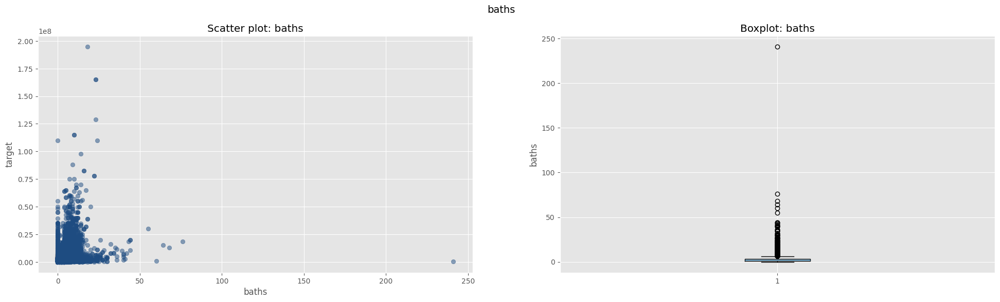

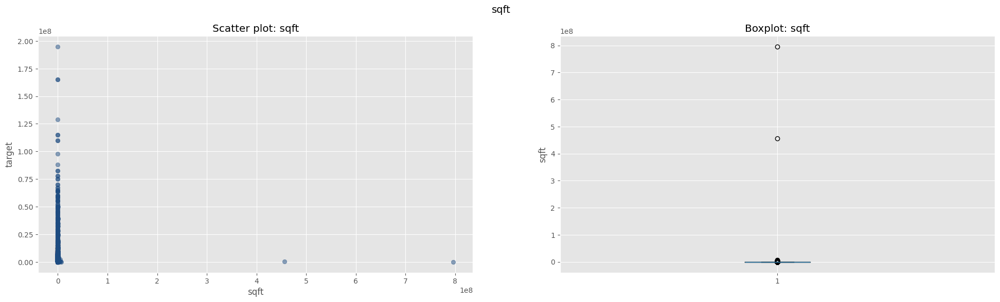

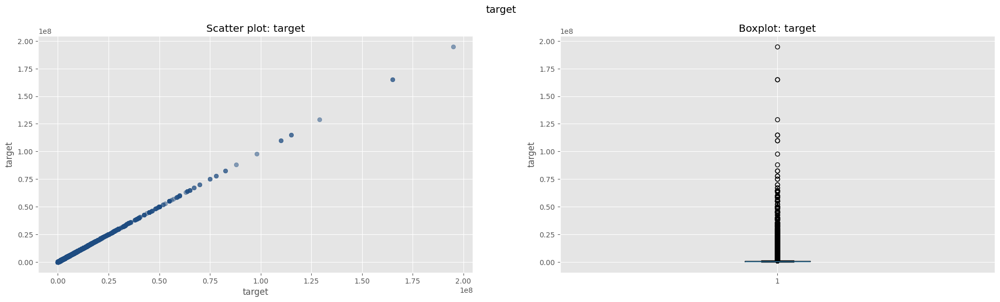

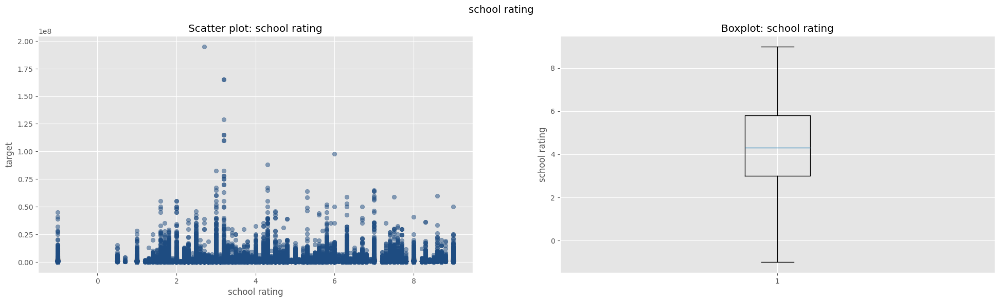

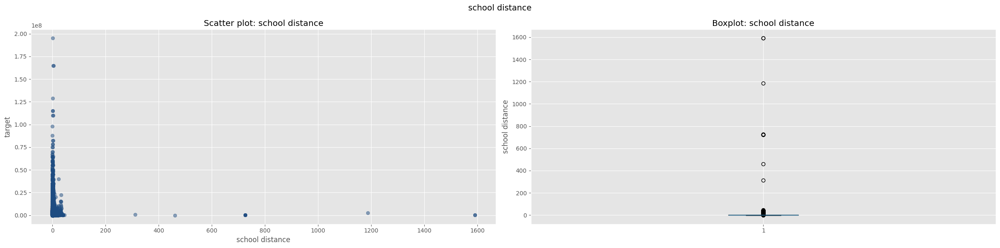

In [229]:
for feature in numeric_features:
    fig, (barplot,boxploot) = plt.subplots(1, 2, figsize=(24, 6)) 
    fig.suptitle(f'{feature}', fontsize=14)
      
    barplot.scatter(data_4[feature], data_4['target'], c='#1e4c81', alpha=0.5)
    barplot.set_title(f'Scatter plot: {feature}')
    barplot.set_xlabel(feature)
    barplot.set_ylabel('target')
    
    boxploot.boxplot(data_4[feature])
    boxploot.set_title(f'Boxplot: {feature}')
    boxploot.set_ylabel(feature)
    
plt.tight_layout()

От выбросов необходимо избавиться.

In [230]:
data_411 = data_4.copy()

### 4.1.1 Признак baths

In [231]:
print(f'Количество пропусков: {data_411["baths"].isna().sum()}\n'
      f'Количество уникальных значений: {data_411["baths"].nunique()}')
print('\nЗначения признака:')
data_411['baths'].value_counts().tail(15)

Количество пропусков: 0
Количество уникальных значений: 47

Значения признака:


baths
28.0     2
34.0     2
29.0     2
241.0    1
55.0     1
25.0     1
43.0     1
41.0     1
76.0     1
35.0     1
64.0     1
39.0     1
42.0     1
60.0     1
68.0     1
Name: count, dtype: int64

In [232]:
mask_411 = (data_411['baths']>20)
baths_outliers = data_411[mask_411]
baths_outliers.shape[0]

89

Чтобы сопоставить, реалистично ли выглядит большое количество ванных в одном объекте жилья, удобно рассчитать коэффициенты:

In [233]:
# Удаление для удобства просмотра:
baths_outliers = baths_outliers.drop(['status', 'fireplace', 'Private pool', 'street','zipcode','Cooling', 'school rating', 'school distance'],axis=1)

# Стоимость одного квадратного фута:
baths_outliers['dollars per sqrft'] = baths_outliers['target']/baths_outliers['sqft']

# Количество ванных на 1000 кв. футов (примерно 93 кв. метра):
baths_outliers['bathrooms per sqrft'] = baths_outliers['baths']/baths_outliers['sqft']*1000

display(baths_outliers)

,propertyType,baths,city,sqft,state,target,Parking,Built in a period,dollars per sqrft,bathrooms per sqrft
9788,single_family_home,241.0,mcallen,3770,TX,449000,True,2010-s,119.098143,63.925729
18908,multi_family_home,40.0,lauderhill,1100,FL,1704000,True,1970-s,1549.090909,36.363636
24805,multi_family_home,24.0,los angeles,12582,CA,6500000,True,Early 1900-s,516.611032,1.907487
25673,multi_family_home,22.0,detroit,18473,MI,66000,False,1920-s,3.572782,1.190927
28864,multi_family_home,22.0,charlotte,16675,NC,2189000,True,1950-s,131.274363,1.319340
...,...,...,...,...,...,...,...,...,...,...
298346,multi_family_home,68.0,sunland,37394,CA,12800000,True,1980-s,342.300904,1.818474
312197,single_family_home,22.0,los angeles,30000,CA,78000000,True,1930-s,2600.000000,0.733333
316451,multi_family_home,44.0,boston,21210,MA,20000000,False,Early 1900-s,942.951438,2.074493
318608,multi_family_home,23.0,fresno,15968,CA,1615000,True,1960-s,101.139780,1.440381


Хотя по сопоставлению характеристик (отношения количества ванных к площади) в существование большинства из этих объектов можно поверить, их все лучше удалить.

In [234]:
data_411.drop(data_411[mask_411].index, inplace=True)

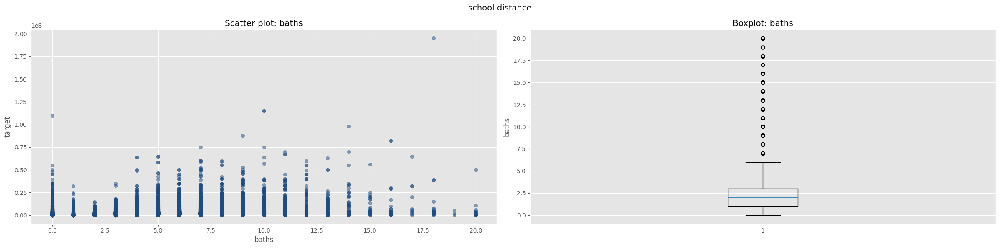

In [235]:
fig, (barplot,boxploot) = plt.subplots(1, 2, figsize=(24, 6)) 
fig.suptitle(f'{feature}', fontsize=14)
      
barplot.scatter(data_411['baths'], data_411['target'], c='#1e4c81', alpha=0.5)
barplot.set_title(f'Scatter plot: baths')
barplot.set_xlabel('baths')
barplot.set_ylabel('target')
    
boxploot.boxplot(data_411['baths'])
boxploot.set_title(f'Boxplot: baths')
boxploot.set_ylabel('baths')
    
plt.tight_layout()

### 4.1.2. Признак sqft

In [236]:
data_412 = data_411.copy()

Аналогичным образом следует почистить  признак sqft

In [237]:
mask_412 = ((data_412['sqft'] < 100)  | (data_412['sqft'] > 150000))
sqft_outliers = data_412[mask_412]
sqft_outliers.shape[0]


11224

In [238]:
# Удаление выбросов:
data_412.drop(data_412[mask_412].index, inplace=True)

Результат после очистки на графике

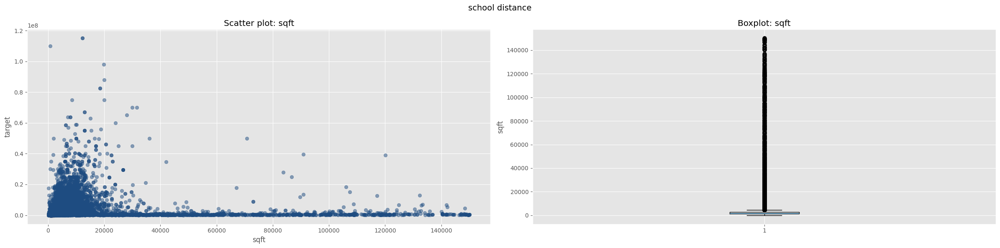

In [239]:
fig, (barplot,boxploot) = plt.subplots(1, 2, figsize=(24, 6)) 
fig.suptitle(f'{feature}', fontsize=14)
      
barplot.scatter(data_412['sqft'], data_412['target'], c='#1e4c81', alpha=0.5)
barplot.set_title(f'Scatter plot: sqft')
barplot.set_xlabel('sqft')
barplot.set_ylabel('target')
    
boxploot.boxplot(data_412['sqft'])
boxploot.set_title(f'Boxplot: sqft')
boxploot.set_ylabel('sqft')
    
plt.tight_layout()

In [240]:
high_squared = data_412[data_412['sqft']>30000]
high_squared.head(25)

,status,propertyType,street,baths,fireplace,city,sqft,zipcode,state,target,Private pool,Cooling,Parking,Built in a period,school rating,school distance
79,for sale,condo,8470 129th st #4a,2.0,False,kew gardens,107250,11415,NY,319000,False,False,False,1960-s,5.3,0.37
122,for sale,single_family_home,20910 41st ave #3c,0.0,False,bayside,109200,11361,NY,270000,False,False,False,1960-s,3.8,0.51
349,for sale,condo,6837 108th st #4f,0.0,False,forest hills,71838,11375,NY,440000,False,False,False,1930-s,3.5,0.26
511,for sale,condo,975 park ave #14b,4.0,True,new york,142075,10028,NY,5300000,False,True,False,1920-s,4.3,0.12
652,for sale,condo,3815 149th st #1l,0.0,False,flushing,114151,11354,NY,295000,False,False,False,1950-s,5.3,0.28
1526,auction,other,0 judson rd,0.0,False,san antonio,119921,78247,TX,89480,False,False,False,unknown year,6.0,0.30
1809,foreclosure,condo,240 e 55th st #8e,0.0,False,new york,32767,10022,NY,1282697,False,False,False,1960-s,5.8,0.09
2025,for sale,land,4823 gus eckert rd,0.0,True,san antonio,68868,78240,TX,785000,False,False,True,1950-s,6.0,0.29
2280,for sale,condo,243 w end ave #1210,0.0,False,new york,105996,10023,NY,425000,False,False,False,1920-s,0.5,0.53
2315,for sale,condo,60 e 9th st #218,0.0,False,new york,140370,10003,NY,749000,False,False,True,1950-s,5.8,0.35


В большинстве случаев это кондоминиумы. Гигантские площади не соответствуют типу жилья, да и другие признаки не соответствуют таким площадям. Например почти 5000 кв. метров жилья в Чикаго ни при каких обстоятельствах не могут стоть всего $223 000 - примерно среднюю цену среднестатистического жилья в США. Это некорректные площади. Всё это нужно удалять.

In [241]:
high_squared.shape[0]

840

In [242]:
sqft_todrop = (data_412['sqft']>30000)
data_412.drop(data_412[sqft_todrop].index, inplace=True)

Оценить результат преобразований можно на графиках.

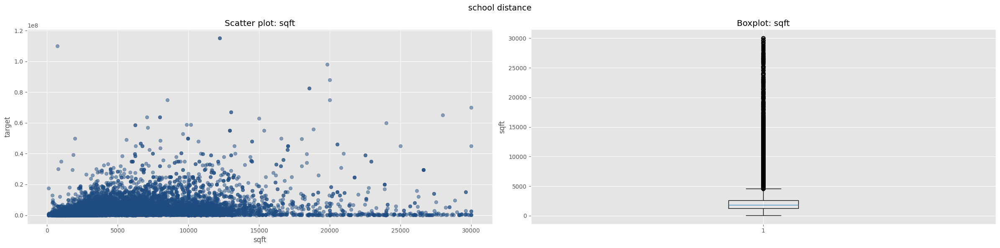

In [243]:
fig, (barplot,boxploot) = plt.subplots(1, 2, figsize=(24, 6)) 
fig.suptitle(f'{feature}', fontsize=14)
      
barplot.scatter(data_412['sqft'], data_412['target'], c='#1e4c81', alpha=0.5)
barplot.set_title(f'Scatter plot: sqft')
barplot.set_xlabel('sqft')
barplot.set_ylabel('target')
    
boxploot.boxplot(data_412['sqft'])
boxploot.set_title(f'Boxplot: sqft')
boxploot.set_ylabel('sqft')
    
plt.tight_layout()

С такими данными можно работать дальше.

### 4.1.3 Признак school distance

In [244]:
data_413 = data_412.copy()

In [245]:
mask_413 = (data_413['school distance'] > 20)
school_dist_outliers = data_413[mask_413]
school_dist_outliers.shape[0]

828

In [246]:
school_dist_outliers.head(15)

,status,propertyType,street,baths,fireplace,city,sqft,zipcode,state,target,Private pool,Cooling,Parking,Built in a period,school rating,school distance
359,for sale,single_family_home,25662 green river dr,3.0,True,san antonio,3031,78260,TX,450000,False,True,True,Early 2000-s,3.0,25.12
649,for sale,single_family_home,12345 desert dove ave,3.0,False,el paso,1892,79938,TX,217580,False,False,False,2010-s,5.0,39.69
654,for sale,single_family_home,14524 dominic azcarate dr,2.0,False,el paso,1637,79938,TX,185950,False,False,False,2010-s,5.0,39.69
662,No info,condo,501 ne 31st st unit 1706,2.0,False,miami,1287,33137,FL,680000,False,False,True,2010-s,1.0,22.50
799,No info,single_family_home,541 ne 159th st,1.0,False,miami,1193,33162,FL,285000,False,True,True,1940-s,1.0,28.60
1125,No info,condo,1855 ne 121st st apt 35,1.0,False,north miami,974,33181,FL,147000,False,True,True,1960-s,2.3,27.70
2141,for sale,single_family_home,325 heavens way,4.0,True,san antonio,3584,78260,TX,675555,False,True,True,2010-s,4.2,24.61
3546,for sale,single_family_home,14704 tierra escape ave,3.0,False,el paso,2184,79938,TX,273000,False,False,False,2010-s,5.0,39.69
3748,No info,single_family_home,10435 nw 69th ter,4.0,False,doral,2890,33178,FL,645650,True,False,False,2010-s,3.0,20.20
3967,for sale,single_family_home,25910 echo mtn,5.0,True,san antonio,4498,78260,TX,819999,False,True,True,Early 2000-s,3.0,25.76


In [247]:
data_413.drop(data_413[mask_413].index, inplace=True)

Признак после очистки на графике

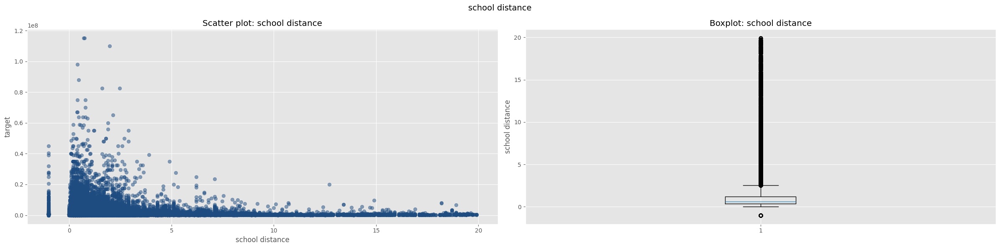

In [248]:
fig, (barplot,boxploot) = plt.subplots(1, 2, figsize=(24, 6)) 
fig.suptitle(f'{feature}', fontsize=14)
      
barplot.scatter(data_413['school distance'], data_413['target'], c='#1e4c81', alpha=0.5)
barplot.set_title(f'Scatter plot: school distance')
barplot.set_xlabel('school distance')
barplot.set_ylabel('target')
    
boxploot.boxplot(data_413['school distance'])
boxploot.set_title(f'Boxplot: school distance')
boxploot.set_ylabel('school distance')
    
plt.tight_layout()

Данные в целом очень несбалансированы, приходится избавляться от десятков и сотен наблюдений.

### 4.1.4 Признак target

In [249]:
data_414 = data_413.copy()

In [250]:
mask_414 = (data_414['target'] > 1500000)
target_outliers = data_414[mask_414]

print(len(target_outliers))

21233


In [251]:
data_414.drop(data_414[mask_414].index, inplace=True)

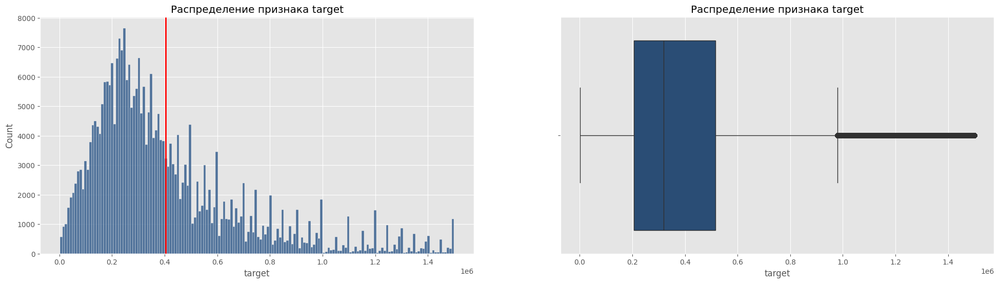

In [252]:
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(24, 6))
histplot = sns.histplot(data_414, x='target', color='#1e4c81', ax=axes[0]);
histplot.set_title('Распределение признака target');
histplot.axvline(data_414['target'].mean(), color='red', lw=2)

boxplot = sns.boxplot(data_414, x='target', color='#1e4c81', ax=axes[1]);
boxplot.set_title('Распределение признака target');

Хотя дорогие объекты являются вполне реальными, в рамках решаемой задачи их всё равно целесообразно удалить.

Характеристики самых дорогих объектов, которые отличают их от остальных, очень искажённо отражены в датасете. Данные изначально замусорены, неполны и иногда недостоверны. А после очистки все особенности объектов унифицированы настолько, что для ML модели не будет видна разница, какие камины, бассейны, гаражи есть в доме.

Таким образом, наличие самых дорогих объектов могло бы только ухудшить качество работы модели. Поэтому необходимо заранее понимать, что обученная на таких данных модель будет плохо работать с самыми дорогими объектами.

In [253]:
data_414.to_csv('housing_data_to_cut.csv', index=False)

### 4.2. Нормализация.

In [589]:
data_42 = data_414.copy()

Тест Шапиро-Уилкса позволяет определить, насколько выборка соответствует нормальному распределению.

Нулевая гипотеза: "Анализируемая выборка происходит из генеральной совокупности, имеющей нормальное распределение".

Если получаемая при помощи теста вероятность ошибки Р оказывается меньше некоторого заранее принятого уровня значимости (например, 0.05), нулевая гипотеза отклоняется: в таком случае можно утверждать, что данные выборки не получены из нормального распределения.

In [590]:
# Каноничный уровень значимости:
alpha = 0.05 

# Тест Шапиро-Уилка:
_, p = stats.shapiro(data_42['target'])

print('p-value = {:.3f}'.format(p))

# Интерпретация результата:
if p <= alpha:
    print('Распределение не нормальное')
else:
    print('Распределение нормальное')

p-value = 0.000
Распределение не нормальное


c:\Users\User\AppData\Local\Programs\Python\Python39\lib\site-packages\scipy\stats\_morestats.py:1882: UserWarning: p-value may not be accurate for N > 5000.
  warnings.warn("p-value may not be accurate for N > 5000.")


"Распределение не нормальное" - ожидаемая формулировка, но 0.000 - неожиданное значение. Визуально распределение не настолько "ненормально". Кроме того, при выполнении кода появилось предупреждение:

UserWarning: p-value may not be accurate for N > 5000.

А в данном случае речь идёт о многократно большем количестве наблюдений, чем 5000.

В таком случае следует построить квантиль-квантиль график (qq-plot): он служит для визуальной оценки, но более информативен, чем обычная гистограмма.

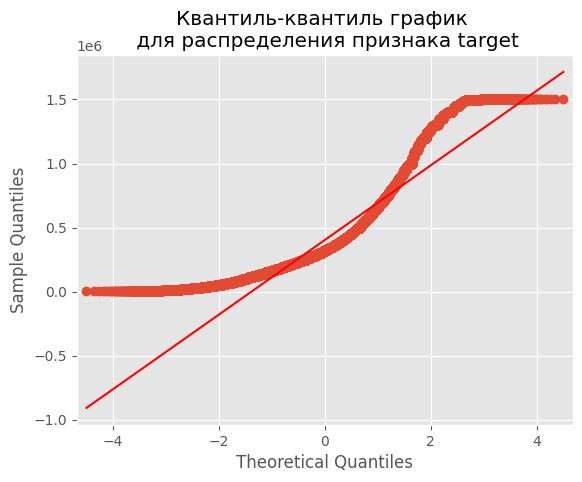

In [591]:
# Параметры квантиль-квантиль графика:
sm.qqplot(data_42['target'], line='s')
plt.title('Квантиль-квантиль график \n для распределения признака target')

plt.show()

Распределение не является нормальным. Его прологарифмировать.

In [592]:
data_42['target_log'] = np.log(data_42['target'])

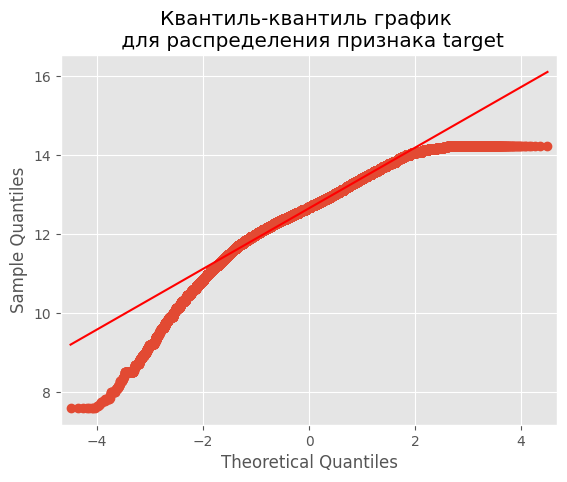

In [593]:
# Параметры квантиль-квантиль графика:
sm.qqplot(data_42['target_log'], line='s')
plt.title('Квантиль-квантиль график \n для распределения признака target')

plt.show()

С логарифмированием чуть лучше, но тоже не во всём диапазоне значений.

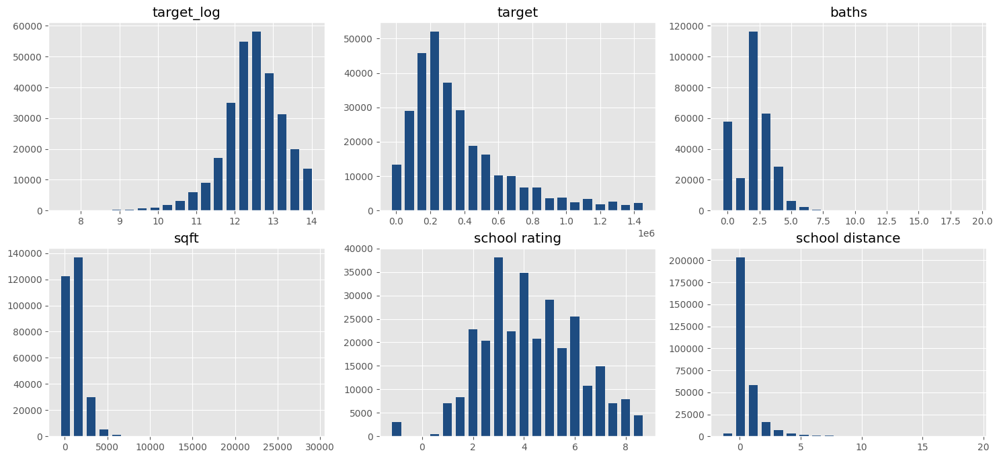

In [594]:
def show_norm_distrib(values):
  columns = min(3, len(values))
  rows = (len(values) - 1) // columns + 1
  fig = plt.figure(figsize = (columns * 6, rows * 4))
  for i, (title, values) in enumerate(values.items()):
    hist, bins = np.histogram(values, bins = 20)
    ax = fig.add_subplot(rows, columns, i + 1)
    ax.bar(bins[:-1], hist, color='#1e4c81', width = (bins[1] - bins[0]) * 0.7)
    ax.set_title(title)
  plt.show()
  
show_norm_distrib({
    'target_log': data_42['target_log'],
    'target': data_42['target'],
    'baths': data_42['baths'],
    'sqft': data_42['sqft'],
    'school rating': data_42['school rating'],
    'school distance': data_42['school distance'],})

Целевой признак в логарифмированном виде выглядит чуть ближе к нормальному распределению с сильной левосторонней асимментрией. У всех остальных признаков асимметрия правосторонняя.

В данных много выбросов. Нормализаторы обрабатывают их по-разному:

In [595]:
# Датафрейм для нормализации
numeric_df = data_42[numeric_features]
col_names_42 = list(numeric_df.columns)

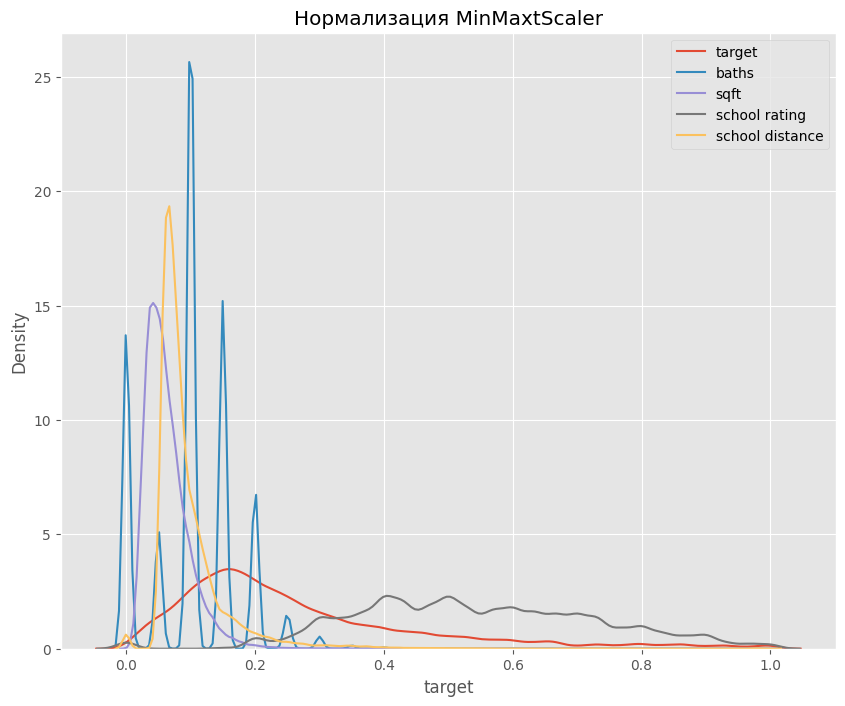

In [596]:
# Нормализация с помощью MinMaxScaler
mm_scaler = MinMaxScaler()

data_mm = mm_scaler.fit_transform(numeric_df)
data_mm = pd.DataFrame(data_mm, columns=col_names_42)
fig, (ax1) = plt.subplots(ncols=1, figsize=(10,8))
ax1.set_title('Нормализация MinMaxtScaler')

sns.kdeplot(data_mm['target'], ax=ax1, label='target')
sns.kdeplot(data_mm['baths'], ax=ax1, label='baths')
sns.kdeplot(data_mm['sqft'], ax=ax1, label='sqft')
sns.kdeplot(data_mm['school rating'], ax=ax1, label='school rating')
sns.kdeplot(data_mm['school distance'], ax=ax1, label='school distance')
plt.legend()

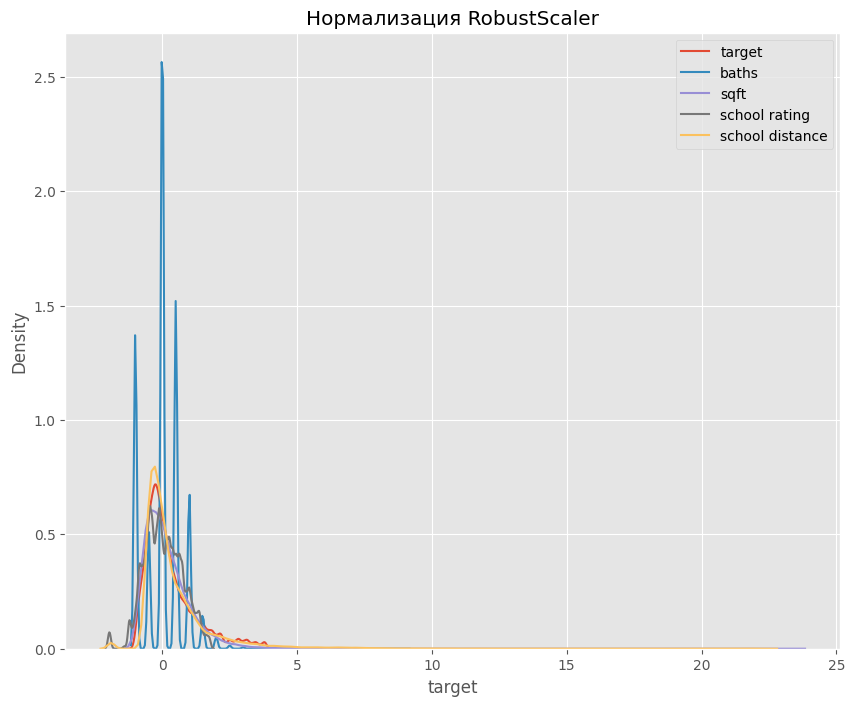

In [597]:
# Нормализация с помощью RobustScaler
r_scaler = RobustScaler()

data_r = r_scaler.fit_transform(numeric_df)
data_r = pd.DataFrame(data_r, columns=col_names_42)
fig, (ax1) = plt.subplots(ncols=1, figsize=(10,8))
ax1.set_title('Нормализация RobustScaler')

sns.kdeplot(data_r['target'], ax=ax1, label='target')
sns.kdeplot(data_r['baths'], ax=ax1, label='baths')
sns.kdeplot(data_r['sqft'], ax=ax1, label='sqft')
sns.kdeplot(data_r['school rating'], ax=ax1, label='school rating')
sns.kdeplot(data_r['school distance'], ax=ax1, label='school distance')
plt.legend()

RobustScaler ожидаемо лучше справился с выбросами, его целесообразно применить к числовым признакам.

Можно удалить признак target_log, он принципиально не улучшил ситуацию.

In [598]:
data_42 = data_42.drop('target_log',axis=1) 

In [599]:
for column in numeric_features:
    data_42[column] = r_scaler.fit_transform(data_42[[column]])[:,0]

### 4.3. Анализ категориальных признаков

Влияние категориальных признаков на стоимость объекта удобно рассмотреть на графиках типа boxplot.

In [600]:
categorial_features = ['status', 'propertyType', 'street', 'city', 'zipcode', 'state', 'Built in a period']

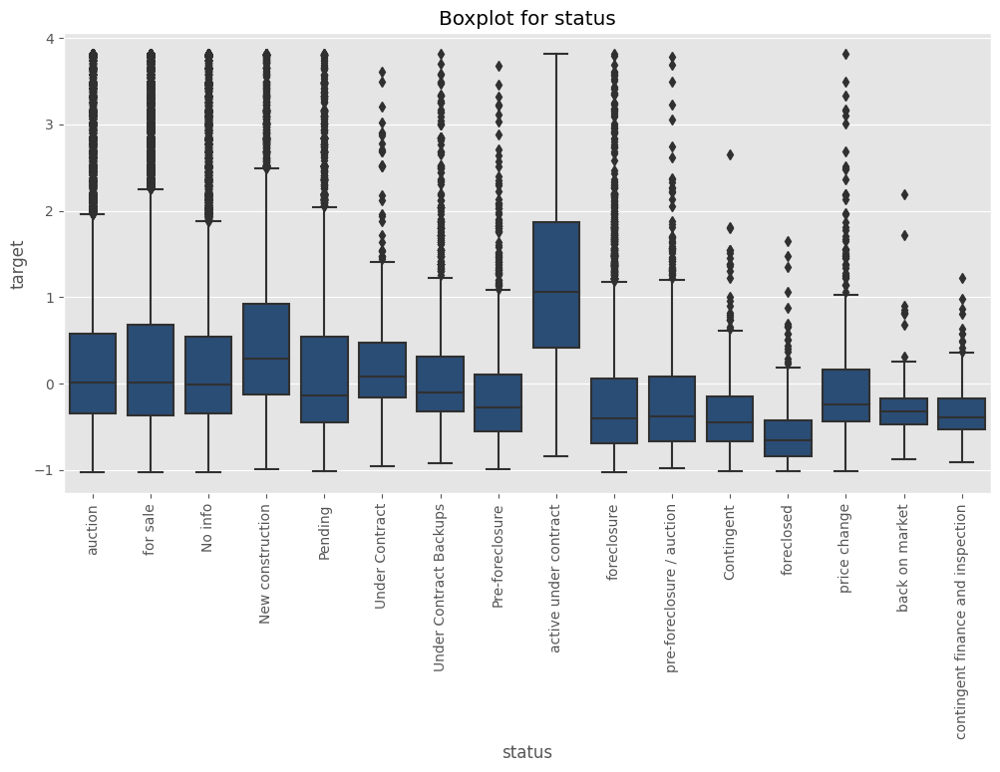

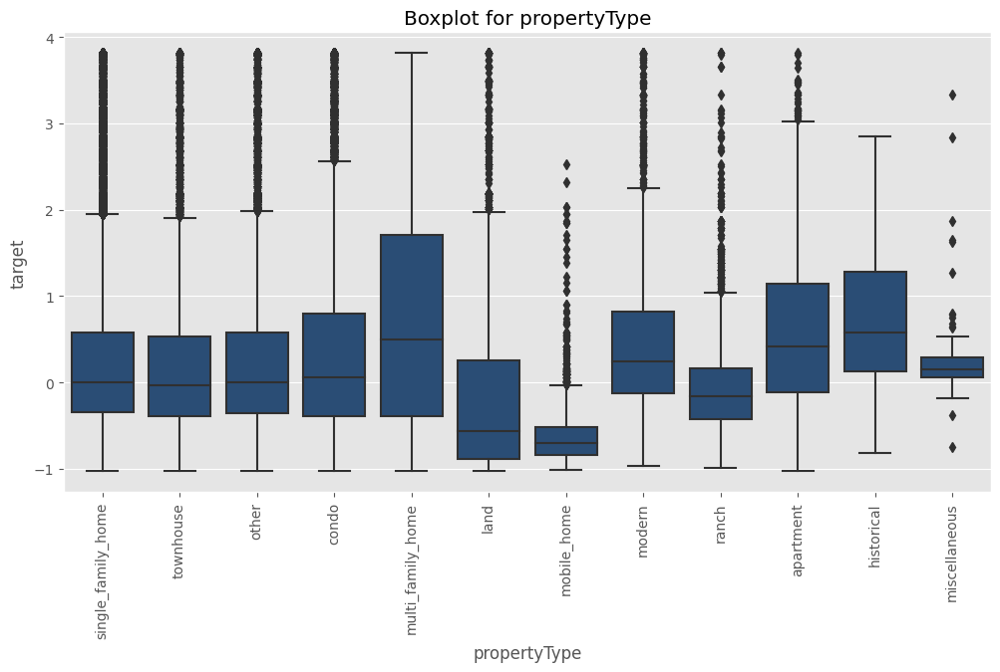

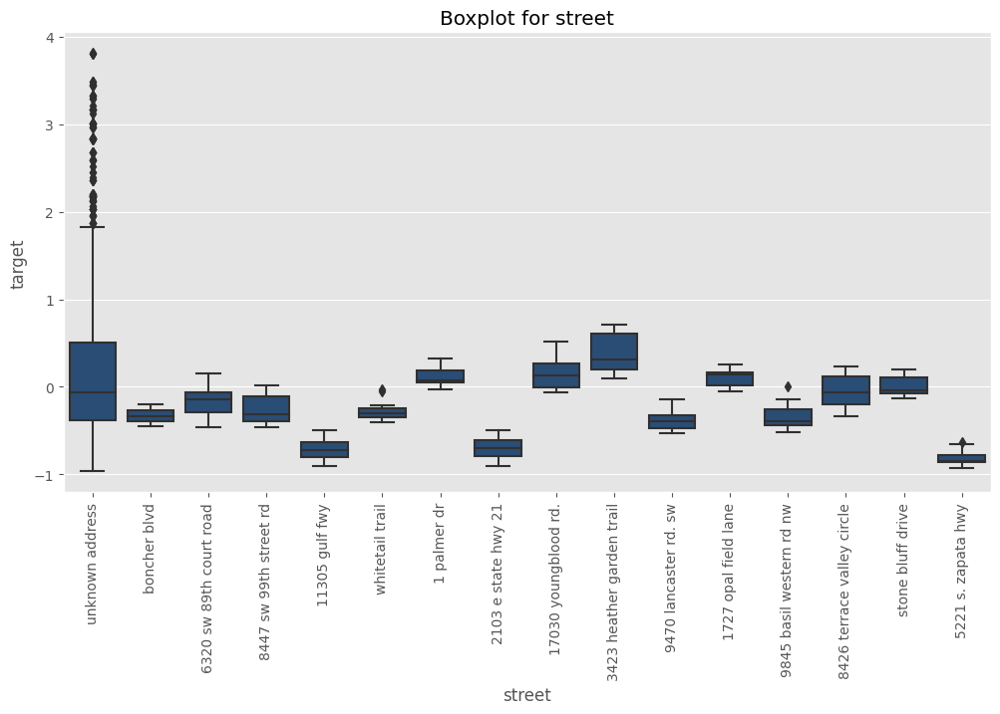

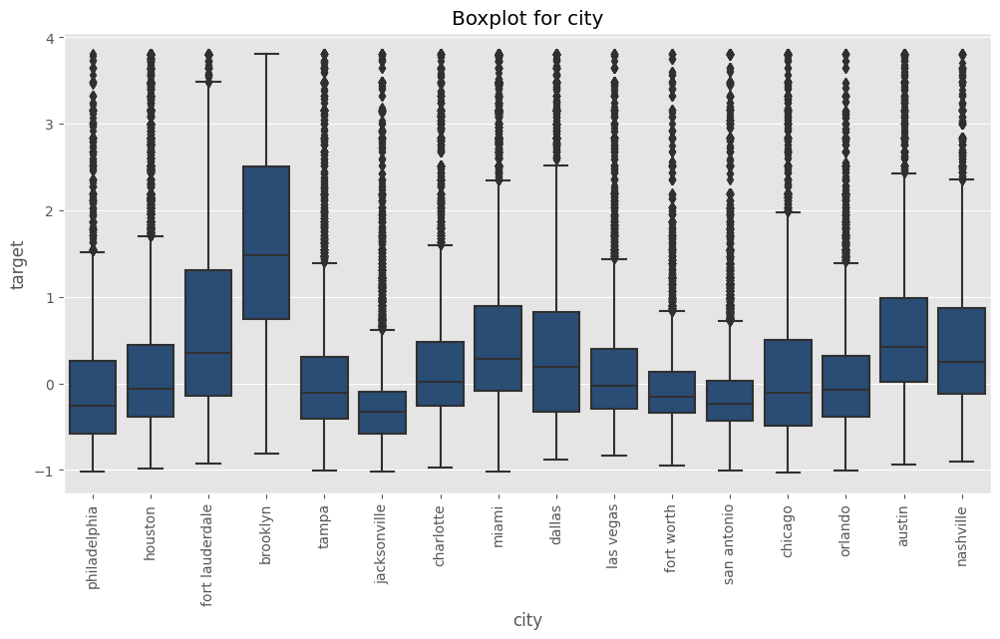

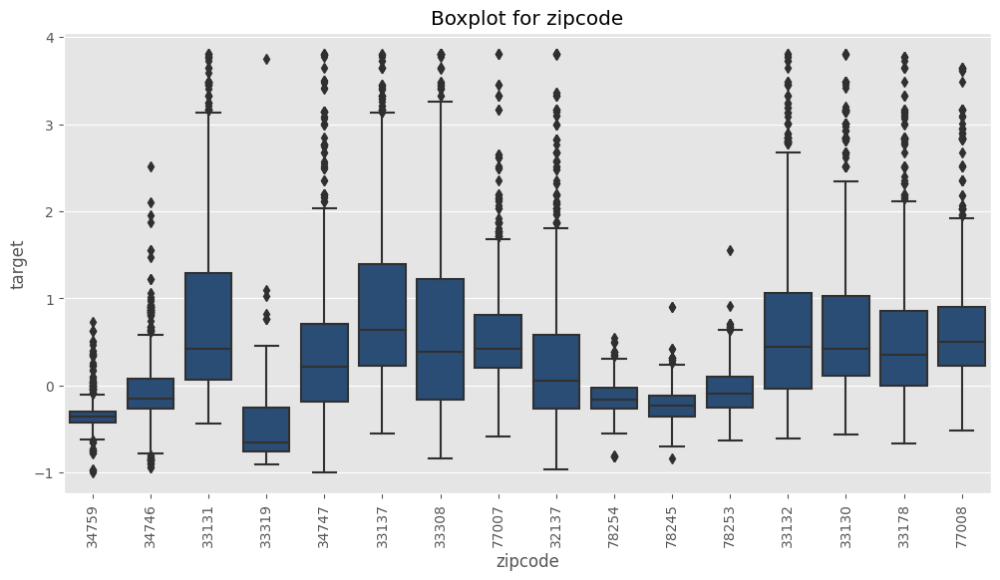

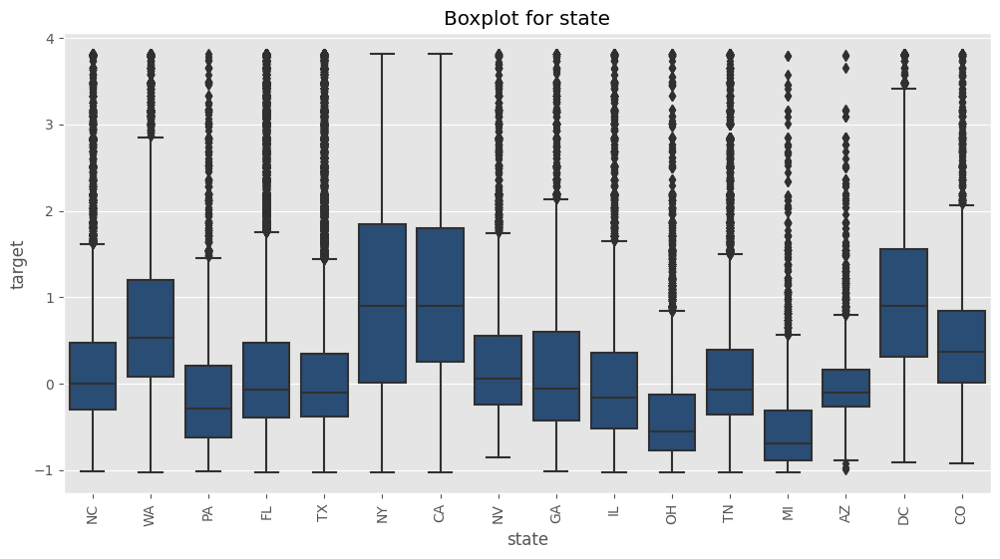

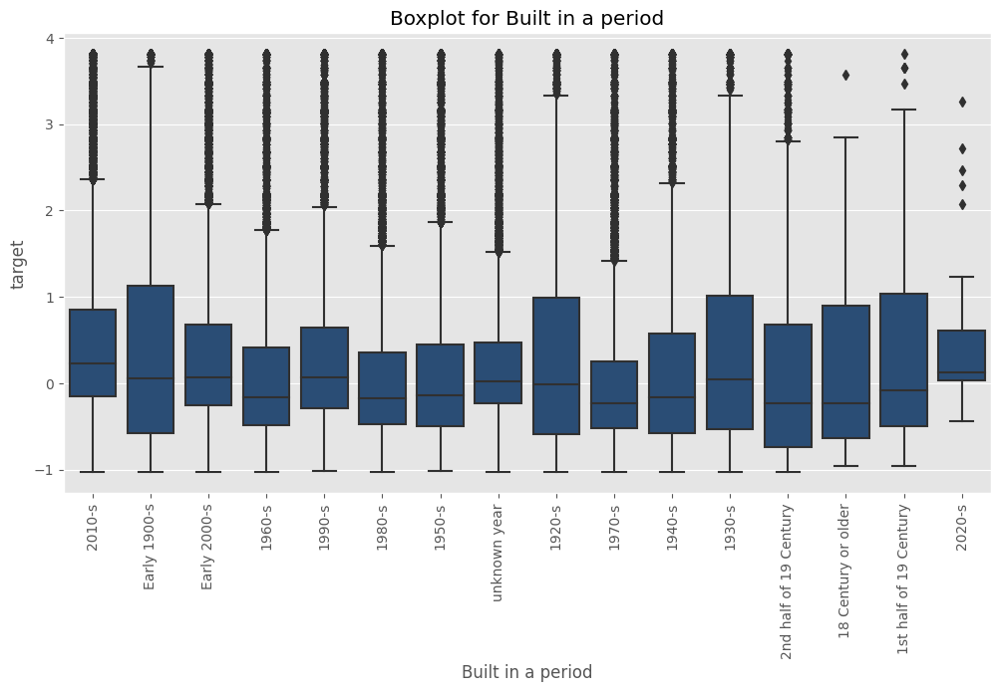

In [601]:
def get_boxplot(column):
    fig, ax = plt.subplots(figsize = (12, 6))
    sns.boxplot(x=column, y='target', color='#1e4c81',
                data=data_42.loc[data_42.loc[:, column].isin(data_42.loc[:, column].value_counts().index[:16])],ax=ax)
    plt.xticks(rotation=90)
    ax.set_title('Boxplot for ' + column)
    plt.show()
    
for col in chain(categorial_features):
    get_boxplot(col)

In [602]:
for col in categorial_features:
   unique_values = data_42[col].nunique()
   print(f"Количество уникальных значений в категориальной колонке {col}: {unique_values}")

Количество уникальных значений в категориальной колонке status: 58
Количество уникальных значений в категориальной колонке propertyType: 12
Количество уникальных значений в категориальной колонке street: 263522
Количество уникальных значений в категориальной колонке city: 1681
Количество уникальных значений в категориальной колонке zipcode: 5712
Количество уникальных значений в категориальной колонке state: 34
Количество уникальных значений в категориальной колонке Built in a period: 16


Признаки с большим количеством уникальных значений перегрузят модель ненужной информацией.

Признаки **state**, **zipcode** и **street** логически связаны между собой. При этом признак **street** заведомо плохо подходит для данной модели машинного обучения: допустим, объект **A** есть в датасете. А соседний дом **B** является его полной копией и отличается адресом на 1 символ от **А**, но он отсутствует в базе, на которой обучена модель. В результате модель отнесёт его к категории unknown address. На данном этапе с этим признаком пора прощаться.

С **zipcode**, **city** и **state** ситуация сложнее: **zipcode** можно представить как более детализованную интерпретацию признаков **state** и **city**, почтовый индекс точнее идентфицирует районы с определённой стоимостью жилья, чем целый штат. Но проблема в том, что в США примерно 42000 почтовых индексов, а в датасете на данном этапе обработки осталось 5743. При обучении модели в рамках данного проекта может быть и можно оперировать признаком **zipcode**, чтобы на тестовой выборке получить хороший результат. Но в реальной жизни такая модель не сможет никак использовать данные о zipcode объекта, который находится где-то за пределами зоны действия zipcod'ов из датасета.

In [603]:
data_43 = data_42.copy()

In [604]:
data_43 = data_43.drop('street', axis=1)

### 4.4. Матрица корреляций

C:\Users\User\AppData\Local\Temp\ipykernel_4828\3174251204.py:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(round(data_43.corr(method='spearman'), 2), vmin=-1, vmax=1, center= 0, cmap= 'coolwarm', annot=True)


<Axes: >

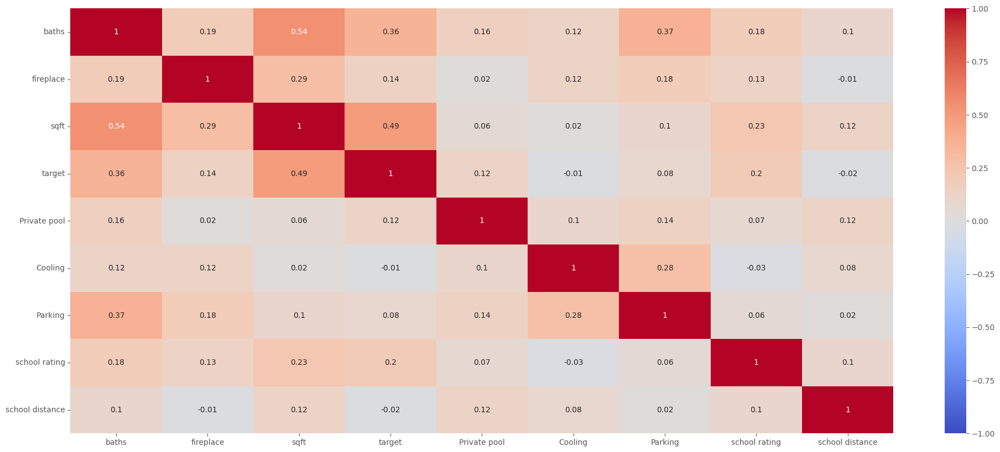

In [605]:
fig, axes = plt.subplots(figsize=(24, 10))
sns.heatmap(round(data_43.corr(method='spearman'), 2), vmin=-1, vmax=1, center= 0, cmap= 'coolwarm', annot=True)

Корреляционная связь преимущественно слабая, в редких случаях средняя. О коллинеарности и говорить не приходится. На этом можно перейти к следующему шагу - закодировать признаки.
  
    
Забегая вперёд, стоит сказать о том, что модели в итоге обучены на всех признаках. Но было бы разумно на данном этапе удалить те из них, которые не оказывают почти никакого влияния на target - в первую очередь **Cooling** и **school distance**, возможно - **parking**. Это сэкономило бы много времени при обучении моделей и особенно при подборе оптимальных параметров.

Интересно выглядит отрицательный характер связи (почти отсутствующей) **target** и **Cooling**: это противоречит здравому смыслу. Очевидно, что кодирование по принципу Да/Нет вместо более детальной обработки признака с извлечением нескольких категорий было не лучшим решением (или наличие системы кондиционирования в масштабах стоимости недвижимости действительно пустяковый фактор - что тоже возможно, но не доказано в рамках данного исследования).

Признак **school distance** содержит множество значений и далее закодирован с помощью BinaryEncoder. То есть из этого почти бесполезного признака получилось несколько бесполезных признаков, которыми были загружены вычислительные мощности, и процесс выбора модели занял больше времени.

### 4.5. Кодирование признаков

In [606]:
data_45 = data_43.copy()

In [607]:
data_45.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 296499 entries, 0 to 330712
Data columns (total 15 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   status             296499 non-null  object 
 1   propertyType       296499 non-null  object 
 2   baths              296499 non-null  float64
 3   fireplace          296499 non-null  bool   
 4   city               296499 non-null  object 
 5   sqft               296499 non-null  float64
 6   zipcode            296499 non-null  object 
 7   state              296499 non-null  object 
 8   target             296499 non-null  float64
 9   Private pool       296499 non-null  bool   
 10  Cooling            296499 non-null  bool   
 11  Parking            296499 non-null  bool   
 12  Built in a period  296499 non-null  object 
 13  school rating      296499 non-null  float64
 14  school distance    296499 non-null  float64
dtypes: bool(4), float64(5), object(6)
memory usage: 28.

In [609]:
data_coded = data_45.copy()

In [608]:
# Эти признаки булево кодированы:
binary_features = ['fireplace', 'Private pool', 'Cooling', 'Parking']

In [610]:
# Применение к признакам LabelEncoder:
label_Enc = LabelEncoder()

for column in binary_features:
    data_coded[column] = label_Enc.fit_transform(data_coded[[column]])

c:\Users\User\AppData\Local\Programs\Python\Python39\lib\site-packages\sklearn\preprocessing\_label.py:114: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
c:\Users\User\AppData\Local\Programs\Python\Python39\lib\site-packages\sklearn\preprocessing\_label.py:114: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
c:\Users\User\AppData\Local\Programs\Python\Python39\lib\site-packages\sklearn\preprocessing\_label.py:114: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
c:\Users\User\AppData\Local\Programs\Python\Python39\lib\site-packages\sklearn\preprocessing\_label.py:114: D

In [614]:
# Кодирование категориальных признаков с помощью BinaryEncoder (поскольку в каждом более 15 уникальных значений):
bin_encoder = ce.BinaryEncoder(data_coded['propertyType'])
propertyType_bin = bin_encoder.fit_transform(data_coded['propertyType'])
data_coded = pd.concat([data_coded,propertyType_bin], axis=1)

bin_encoder = ce.BinaryEncoder(data_coded['status'])
status_bin = bin_encoder.fit_transform(data_coded['status'])
data_coded = pd.concat([data_coded,status_bin], axis=1)

bin_encoder = ce.BinaryEncoder(data_coded['state'])
state_bin = bin_encoder.fit_transform(data_coded['state'])
data_coded = pd.concat([data_coded,state_bin], axis=1)

bin_encoder = ce.BinaryEncoder(data_coded['city'])
city_bin = bin_encoder.fit_transform(data_coded['city'])
data_coded = pd.concat([data_coded,city_bin], axis=1)

bin_encoder = ce.BinaryEncoder(data_coded['zipcode'])
zipcode_bin = bin_encoder.fit_transform(data_coded['zipcode'])
data_coded = pd.concat([data_coded,zipcode_bin], axis=1)

# Немного не хватило периоду постройки дотянуть до OneHotEncoder: признак содержит 16 значений при рекомендованном максимуме в 15.
bin_encoder = ce.BinaryEncoder(data_coded['Built in a period'])
Year_bin = bin_encoder.fit_transform(data_coded['Built in a period'])
data_coded = pd.concat([data_coded,Year_bin], axis=1)

# Удаление исходных признаков:
data_coded.drop(['propertyType', 'status', 'state', 'city', 'zipcode', 'Built in a period'],axis=1,inplace=True)

In [616]:
# размеры датафрейма
data_coded.shape

(296499, 99)

На этом можно закончить данный шаг и сохранить данные.

In [617]:
data_43.to_csv('Housing_data_done.csv', index=False)

In [618]:
data_45.to_csv('Housing_data_norm.csv', index=False)

In [619]:
data_coded.to_csv('Housing_data_coded.csv', index=False)

<p> <a href="#TOC"><kbd>&uarr;</kbd> Назад к оглавлению</a></p>

<p> <a href="#4-разведывательный-анализ-данных"><kbd>&uarr;</kbd> в начало раздела 4. РАЗВЕДЫВАТЕЛЬНЫЙ АНАЛИЗ ДАННЫХ</a></p>

## 5. СОЗДАНИЕ МОДЕЛИ

#### Базовая модель: модель линейной регрессии с параметрами по умолчанию.  

Метрики:
* **MAE** (Средняя абсолютная ошибка, Mean Absolute Error) - это мера ошибки, вычисленная как среднее значение абсолютных значений ошибок. Меньшие значения MAE указывают на лучшую точность модели;
* **MSE** Среднеквадратическая ошибка (Mean Squared Error, MSE) -  квадрат средней ожидаемой разницы между прогнозным значением и фактическим значением, полезна для определения влияния выбросов на точность модели;
* **{R^2}** (коэффициент детерминации) - статистическая мера, которая показывает, насколько хорошо вариации зависимой переменной объясняются моделью.

Разделение выборки методом **train_test_split**.

In [6]:
data_coded = pd.read_csv('Housing_data_coded.csv')

In [7]:
# Кроме разделения, сразу заданы параметры: test_size=0.20, random_state=42, shuffle=True
X = data_coded.drop(['target'], axis=1)
y = data_coded['target']

coded_X_train, coded_X_test, \
coded_y_train, coded_y_test = train_test_split(X, y, test_size=0.20, random_state=42, shuffle=True)

Создание функции для отображения метрик

In [8]:
# Функция принимает выборки, предсказания и название модели, а возвращает словарь со значениями метрик
def metrics_func(y_train,y_test,y_train_pred,y_test_pred, model_name):
    metric_dictionary = {'Metric': ['Train MSE', 'Test MSE', 'Train MAE', 'Test MAE', 'Train R^2', 'Test R^2']}
    mse_train = metrics.mean_squared_error(y_train, y_train_pred)
    mse_test = metrics.mean_squared_error(y_test, y_test_pred)
    mae_train = metrics.mean_absolute_error(y_train, y_train_pred)
    mae_test = metrics.mean_absolute_error(y_test, y_test_pred)
    r2_train = metrics.r2_score(y_train, y_train_pred)
    r2_test = metrics.r2_score(y_test, y_test_pred)
    
    metric_dictionary[model_name] = \
        [round(mse_train,2), round(mse_test,2),\
        round(mae_train,2), round(mae_test,2),\
        round(r2_train,2), round(r2_test,2)]
           
    return metric_dictionary

### Linear regression

In [9]:
# Модель линейной регрессии:
model_LR = LinearRegression(fit_intercept=False)

# Коэффициенты регрессии:
model_LR.fit(coded_X_train, coded_y_train)

# Предсказания с помощью модели:
LR_y_train_pred = model_LR.predict(coded_X_train)
LR_y_test_pred = model_LR.predict(coded_X_test)

Метрики модели линейной регрессии

In [11]:
metrics_LR_dict = metrics_func(coded_y_train, coded_y_test, LR_y_train_pred, LR_y_test_pred, 'Linear Regression')
display(pd.DataFrame(metrics_LR_dict))

,Metric,Linear Regression
0,Train MSE,0.65
1,Test MSE,0.64
2,Train MAE,0.58
3,Test MAE,0.58
4,Train R^2,0.27
5,Test R^2,0.27


С базовой моделью линейной регрессии результат неудовлетворительный.

В первую очередь можно попытаться улучщить результат, выбрав только те признаки, которые оказывают наибольшее влияние на target c помощью метода SelectKBest.

In [23]:
selector_KB = feature_selection.SelectKBest(feature_selection.f_regression, k=65)
selector_KB.fit(coded_X_train, coded_y_train)
best_features_KB = selector_KB.get_feature_names_out()
best_features_KB

array(['baths', 'fireplace', 'sqft', 'Private pool', 'Cooling', 'Parking',
       'school rating', 'school distance', 'propertyType_1',
       'propertyType_2', 'propertyType_3', 'status_1', 'status_2',
       'status_5', 'state_1', 'state_2', 'state_3', 'state_4', 'state_5',
       'city_1', 'city_4', 'city_5', 'city_6', 'city_7', 'city_8',
       'city_10', 'zipcode_1', 'zipcode_4', 'zipcode_5', 'zipcode_6',
       'zipcode_8', 'zipcode_12', 'Built in a period_1',
       'Built in a period_2', 'Built in a period_3',
       'Built in a period_4', 'propertyType_1.1', 'propertyType_2.1',
       'propertyType_3.1', 'status_1.1', 'status_2.1', 'status_5.1',
       'state_1.1', 'state_2.1', 'state_3.1', 'state_4.1', 'state_5.1',
       'city_1.1', 'city_4.1', 'city_5.1', 'city_6.1', 'city_7.1',
       'city_8.1', 'city_10.1', 'zipcode_1.1', 'zipcode_4.1',
       'zipcode_5.1', 'zipcode_6.1', 'zipcode_7.1', 'zipcode_8.1',
       'zipcode_12.1', 'Built in a period_1.1', 'Built in a period_2.

In [24]:
model_LR_KB = LinearRegression()
model_LR_KB.fit(coded_X_train[best_features_KB], coded_y_train)
y_train_predict = model_LR_KB.predict(coded_X_train[best_features_KB])
y_test_predict = model_LR_KB.predict(coded_X_test[best_features_KB])

metrics_dict_LR_KB_dict = metrics_func(coded_y_train, coded_y_test, y_train_predict, y_test_predict, 'Best features(LR)')
display(pd.DataFrame(metrics_dict_LR_KB_dict))

,Metric,Best features(LR)
0,Train MSE,0.65
1,Test MSE,0.65
2,Train MAE,0.58
3,Test MAE,0.58
4,Train R^2,0.26
5,Test R^2,0.27


Результат не улучшился. При K < 65 R-квадрат снижается.

Следующая мера - построение модели на полиномиальных признаках. Но хороших результатов от этой меры ждать не приходится: метод возводит признаки в степень, а значительная часть признаков закодирована как 0 и 1. Это не даст результатов.

### ElasticNetCV

In [25]:
model_EN = ElasticNetCV(cv=5, random_state=42)

parameters = { 'l1_ratio': np.arange (0.01,1., 0.01)}

grid = GridSearchCV(estimator=model_EN,param_grid= parameters, cv=5,scoring='r2', verbose= 2, n_jobs= -1)
grid.fit(coded_X_train, coded_y_train)

best_params_EN = grid.best_params_

model_EN_best = ElasticNetCV(l1_ratio=best_params_EN['l1_ratio'], cv=5, random_state=42)

model_EN_best.fit(coded_X_train, coded_y_train)


encv_y_train_pred = model_EN_best.predict(coded_X_train)
encv_y_test_pred = model_EN_best.predict(coded_X_test)

Fitting 5 folds for each of 99 candidates, totalling 495 fits


In [ ]:
#metrics_dict_LR_poly = metrics_func(coded_y_train, coded_y_test, poly_y_train_pred, poly_y_test_pred, 'PolynomialFeatures(LR)')
#display(pd.DataFrame(metrics_dict_LR_poly))

In [26]:
metrics_encv_dict = metrics_func(coded_y_train, coded_y_test, encv_y_train_pred, encv_y_test_pred, 'ElasticNetCV(optimal)')
display(pd.DataFrame(metrics_encv_dict))
print(best_params_EN)

,Metric,ElasticNetCV(optimal)
0,Train MSE,0.65
1,Test MSE,0.64
2,Train MAE,0.58
3,Test MAE,0.58
4,Train R^2,0.27
5,Test R^2,0.28


{'l1_ratio': 0.99}


In [27]:
model_DT = DecisionTreeRegressor(random_state=42)
model_DT.fit(coded_X_train, coded_y_train)

dt_y_train_pred = model_DT.predict(coded_X_train)
dt_y_test_pred = model_DT.predict(coded_X_test)

In [28]:
metrics_dt_dict = metrics_func(coded_y_train, coded_y_test, dt_y_train_pred, dt_y_test_pred, 'DecisionTree Regressor')
display(pd.DataFrame(metrics_dt_dict))

,Metric,DecisionTree Regressor
0,Train MSE,0.00
1,Test MSE,0.42
2,Train MAE,0.00
3,Test MAE,0.35
4,Train R^2,1.00
5,Test R^2,0.53


Переобучение, необходимо подбирать глубину дерева

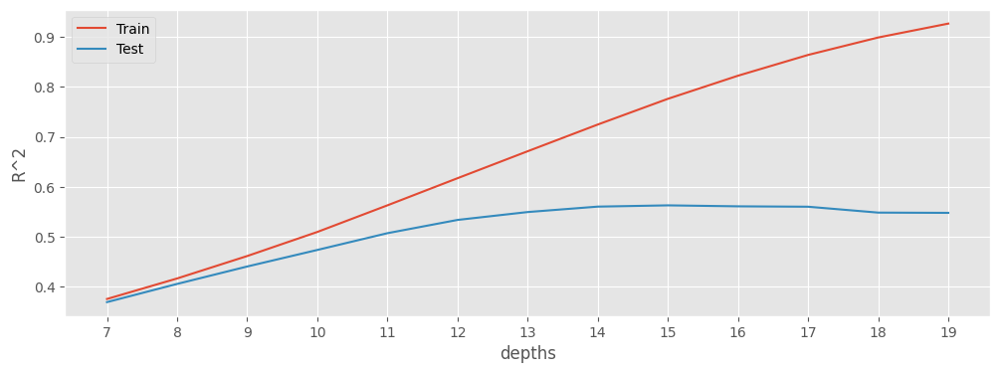

In [29]:
max_depths = range(7, 20)

train_scores = []
test_scores = []
for depth in max_depths:
    
    model_DT = DecisionTreeRegressor(max_depth=depth, random_state=42)
    
    model_DT.fit(coded_X_train, coded_y_train)
    
    dt_y_train_pred = model_DT.predict(coded_X_train)
    dt_y_test_pred = model_DT.predict(coded_X_test)
    
    train_scores.append(metrics.r2_score(coded_y_train, dt_y_train_pred))
    test_scores.append(metrics.r2_score(coded_y_test, dt_y_test_pred))
    
    

fig, ax = plt.subplots(figsize=(12, 4)) 
ax.plot(max_depths, train_scores, label='Train') 
ax.plot(max_depths, test_scores, label='Test') 
ax.set_xlabel('depths') 
ax.set_ylabel('R^2') 
ax.set_xticks(max_depths) 
ax.xaxis.set_tick_params(rotation=0) 
ax.legend(); 

На графике видно как расходятся значения метрики на тестовой и обучающей выборке в зависимости от изменения глубины деревьев. Для опримизмции результата выбрана глубина 12:

In [30]:
model_DT_optimized = DecisionTreeRegressor(max_depth=12 , random_state=42)
model_DT_optimized.fit(coded_X_train, coded_y_train)

dt_optimized_y_train_pred = model_DT_optimized.predict(coded_X_train)
dt_optimized_y_test_pred = model_DT_optimized.predict(coded_X_test)

In [31]:
metrics_DT_optimized_dict = metrics_func(\
    coded_y_train, coded_y_test, \
    dt_optimized_y_train_pred, dt_optimized_y_test_pred, 'DecisionTreeRegressor(optimal)')
display(pd.DataFrame(metrics_DT_optimized_dict))

,Metric,DecisionTreeRegressor(optimal)
0,Train MSE,0.34
1,Test MSE,0.41
2,Train MAE,0.39
3,Test MAE,0.43
4,Train R^2,0.62
5,Test R^2,0.53


Удалось снизить переобучиность модели, но она все еще остается крайне высокой.

### RandomForest Regression

*RandomForestRegressor* - модель бэггинга. Случайный лес использует усреднение для повышения точности прогнозирования и контроля переобучения. 

In [32]:
model_RF = RandomForestRegressor(random_state=42)

model_RF.fit(coded_X_train, coded_y_train)

rf_y_train_pred = model_RF.predict(coded_X_train)
rf_y_test_pred = model_RF.predict(coded_X_test)

In [33]:
metrics_RF_dict = metrics_func(coded_y_train, coded_y_test, rf_y_train_pred, rf_y_test_pred, 'RandomForestRegressor')
display(pd.DataFrame(metrics_RF_dict))

,Metric,RandomForestRegressor
0,Train MSE,0.03
1,Test MSE,0.20
2,Train MAE,0.10
3,Test MAE,0.27
4,Train R^2,0.97
5,Test R^2,0.77


Видим что модель *RandomForestRegressor* справилась лучше чем наши бейслайн, ЭластикНет, Дерево решений. Предсказания точнее, определение зависимости моделью выросло более чем в два раза. При этом наблюдается существенное переобучение.  

Посмотрим можно ли улучшить модель изменяя ее параметры:

In [34]:
rf_parameters = { 'n_estimators': [100, 200, 300],
              'max_depth': [4, 7, 13],
              'min_samples_leaf': [1, 4, 8],
              'min_samples_split': [2, 5, 10] }

grid = GridSearchCV(estimator=model_RF, param_grid=rf_parameters, cv=5, \
    scoring='neg_mean_squared_error', verbose=2, n_jobs=-1)
grid.fit(coded_X_train, coded_y_train)

rf_best_parameters = grid.best_params_

srf_best_model = RandomForestRegressor(n_estimators=rf_best_parameters['n_estimators'], 
        max_depth = rf_best_parameters['max_depth'], min_samples_leaf = rf_best_parameters['min_samples_leaf'], 
        min_samples_split =  rf_best_parameters['min_samples_split'], random_state=42)

srf_best_model.fit(coded_X_train, coded_y_train)
srf_best_y_train_pred = srf_best_model.predict(coded_X_train)
srf_best_y_test_pred = srf_best_model.predict(coded_X_test)

grid.best_params_

Fitting 5 folds for each of 81 candidates, totalling 405 fits


{'max_depth': 13,
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'n_estimators': 300}

In [35]:
metrics_SRF_best_dict = metrics_func(coded_y_train, coded_y_test, srf_best_y_train_pred, srf_best_y_test_pred, 'RandomForestRegressor(best)')
display(pd.DataFrame(metrics_SRF_best_dict))
print(rf_best_parameters)

,Metric,RandomForestRegressor(best)
0,Train MSE,0.24
1,Test MSE,0.31
2,Train MAE,0.33
3,Test MAE,0.37
4,Train R^2,0.73
5,Test R^2,0.65


{'max_depth': 13, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 300}


Степень переобучения модели снизилась, но и предсказательная способность тоже.

### GradientBoostingRegressor

*GradientBoostingRegressor* строит аддитивную модель поэтапно, что позволяет оптимизировать произвольные дифференцируемые функции потерь. Посмотрим какие показатели даст модель:

In [37]:
model_GB = GradientBoostingRegressor(
    max_depth=8, 
    n_estimators=500, 
    random_state=42, 
    learning_rate=0.02
)

model_GB.fit(coded_X_train, coded_y_train)

gb_y_train_pred  = model_GB.predict(coded_X_train)
gb_y_test_pred = model_GB.predict(coded_X_test)

In [38]:
metrics_GB_dict = metrics_func(coded_y_train, coded_y_test, gb_y_train_pred, gb_y_test_pred, 'GradientBoostingRegressor')
display(pd.DataFrame(metrics_GB_dict))

,Metric,GradientBoostingRegressor
0,Train MSE,0.22
1,Test MSE,0.25
2,Train MAE,0.31
3,Test MAE,0.33
4,Train R^2,0.75
5,Test R^2,0.72


Значения метрик *GradientBoostingRegressor* чуть лучше, чем результаты оптимизированной *RandomForestRegressor*, при этом почти не стало переобучения.

А кроме того, *GradientBoostingRegressor* справился с задачей за 16 минут, а *RandomForestRegressor* - за 517!

### CatBoostRegression

*CatBoostRegressor* может работать с категориальными признаками без их кодирования. И поскольку датасет в данной задаче всё равно отличается от того, на котором учились предыдушие модели, заодно можно исправить недоработку, совершённую на предыдущем этапе - избавиться от признаков, имеющих самую низкую корреляционную связь с target.

In [43]:
data_cat_boost = pd.read_csv('Housing_data_norm.csv')

In [44]:
# Удаление признаков, которые почти никак не скоррелированы с целевым:
data_cat_boost = data_cat_boost.drop(['Cooling', 'school distance', 'Parking'],axis=1)

In [55]:
data_cat_boost.to_csv('Housing_data_CatBoost.csv', index=False)

In [45]:
data_cat_boost.head(1)

,status,propertyType,baths,fireplace,city,sqft,zipcode,state,target,Private pool,Built in a period,school rating
0,auction,single_family_home,1.0,True,southern pines,0.939799,28387,NC,0.316962,False,2010-s,0.333333


In [46]:
X = data_cat_boost.drop(['target'], axis=1)
y = data_cat_boost['target']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=42, shuffle=True)

In [301]:
categorial_features = ['status', 'propertyType', 'city', 'zipcode', 'state', 'Built in a period']

In [50]:
model_CB = CatBoostRegressor(random_seed=42, silent=True)

param_grid = {
    'iterations': [100, 300, 500],
    'learning_rate': [0.01, 0.03, 0.1],
    'depth': [4, 6, 8],
    'l2_leaf_reg': [1, 3, 5],}

grid_search = GridSearchCV(estimator=model_CB, param_grid=param_grid, cv=5, scoring='neg_mean_squared_error', verbose=2, n_jobs=-1)
grid_search.fit(X_train, y_train, cat_features=categorial_features)
cb_best_params = grid_search.best_params_

best_model_CB = CatBoostRegressor(iterations=cb_best_params['iterations'], learning_rate=cb_best_params['learning_rate'], 
                                  depth=cb_best_params['depth'], l2_leaf_reg=cb_best_params['l2_leaf_reg'], random_seed=42, silent=True)

best_model_CB.fit(X_train, y_train, cat_features=categorial_features)

cb_y_train_pred = best_model_CB.predict(X_train)
cb_y_test_pred = best_model_CB.predict(X_test)

Fitting 5 folds for each of 81 candidates, totalling 405 fits


In [51]:
metrics_CB_dict = metrics_func(y_train, y_test, cb_y_train_pred, cb_y_test_pred, 'CatBoostRegressor(Optimal)')
display(pd.DataFrame(metrics_CB_dict))
print(cb_best_params)

,Metric,CatBoostRegressor(Optimal)
0,Train MSE,0.16
1,Test MSE,0.17
2,Train MAE,0.25
3,Test MAE,0.26
4,Train R^2,0.82
5,Test R^2,0.80


{'depth': 8, 'iterations': 500, 'l2_leaf_reg': 1, 'learning_rate': 0.1}


### СРАВНЕНИЕ РЕЗУЛЬТАТОВ МОДЕЛЕЙ

In [54]:
comparative_dict = metrics_LR_dict | metrics_dict_LR_KB_dict | metrics_encv_dict | metrics_dt_dict |\
    metrics_DT_optimized_dict | metrics_RF_dict | metrics_SRF_best_dict | metrics_GB_dict |\
        metrics_CB_dict
display(pd.DataFrame(comparative_dict))

,Metric,Linear Regression,Best features(LR),ElasticNetCV(optimal),DecisionTree Regressor,DecisionTreeRegressor(optimal),RandomForestRegressor,RandomForestRegressor(best),GradientBoostingRegressor,CatBoostRegressor(Optimal)
0,Train MSE,0.65,0.65,0.65,0.00,0.34,0.03,0.24,0.22,0.16
1,Test MSE,0.64,0.65,0.64,0.42,0.41,0.20,0.31,0.25,0.17
2,Train MAE,0.58,0.58,0.58,0.00,0.39,0.10,0.33,0.31,0.25
3,Test MAE,0.58,0.58,0.58,0.35,0.43,0.27,0.37,0.33,0.26
4,Train R^2,0.27,0.26,0.27,1.00,0.62,0.97,0.73,0.75,0.82
5,Test R^2,0.27,0.27,0.28,0.53,0.53,0.77,0.65,0.72,0.80


С задачей лучше других справляются ансамблевые методы: *RandomForestRegressor(best)*, *GradientBoostingRegressor* и *CatBoostRegressor(Optimal)*. У *CatBoostRegressor(Optimal)* помимо самого высокого результата метрики R-квадрат необходимо отметить и очень маленькую разницу между этим показателем на тренировочной и тестовой выборках.

Таким образом в продакте будет использоваться *CatBoostRegressor(Optimal)*.

<p> <a href="#TOC"><kbd>&uarr;</kbd> Назад к оглавлению</a></p>

<p> <a href="#5-создание-модели"><kbd>&uarr;</kbd> в начало раздела 5. СОЗДАНИЕ МОДЕЛИ</a></p>

## 6. ПРОДАКТ

Сохранение обученной модели в файл *pickle*.  
Создание *requirements.txt*  
Создание *flask* сервера (server.py) и клиента (client.py)  
Создание *docker*-контейнера на основе *tiangolo/uwsgi-nginx-flask*  

In [257]:
with open("best_model_CB.pkl", "wb") as f:
    pickle.dump(best_model_CB, f)

In [ ]:
#pip freeze > requirements.txt

In [266]:
with open("best_model_CB.pkl", "rb") as pkl_file:
    loaded_pipe = pickle.load(pkl_file)